In [1]:
import numpy as np 
import pandas as pd 
import os
import pickle
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import torch.optim as optim
from torch.nn import Module, Sequential, Conv2d, ConvTranspose2d, LeakyReLU, BatchNorm2d, ReLU, Tanh, Sigmoid, BCELoss , AvgPool2d, Linear
import torchvision.utils as vutils

%matplotlib inline

In [2]:
dir_data = "/kaggle/input/procedural-environment-generation/dataset/dataset"
img_shape = (256,256,1)
img_paths = [dir_data + '/' + file for file in os.listdir(dir_data)]
img_paths = img_paths[:-6]

In [3]:
img_paths = np.sort(img_paths)

In [4]:
def load_images(img_paths):
    for image in img_paths:
        img = Image.open(image)
        img_array = np.array(img)
        img_array_normalized = (img_array - np.min(img_array)) / (np.max(img_array) - np.min(img_array))
        
        yield np.transpose(np.expand_dims(np.float32(img_array_normalized), axis = 2),(2,0,1))

In [5]:
def plot_images(imgs, grid_size = 5):

    fig = plt.figure(figsize = (6,6))
    plt.axis("off")
    columns = rows = grid_size
    plt.title("Training Images")
    images = load_images(imgs)
    for i in range(1, columns*rows +1):
        
        fig.add_subplot(rows, columns, i)
        plt.axis("off")
        plt.imshow(np.transpose(next(images), (1,2,0)), cmap = 'gray')
        
    plt.show()

In [6]:
dev = 'cuda:0' if torch.cuda.is_available() == True else 'cpu'
device = torch.device(dev)

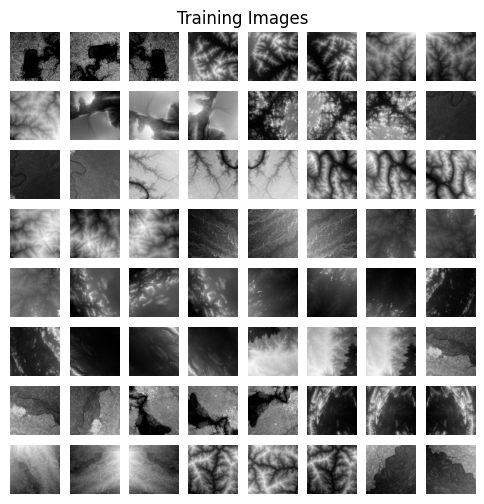

In [7]:
plot_images(img_paths, 8)

In [8]:
class Terrains(Dataset):
    def __init__(self, img_paths):
        '''np array containing all paths to all images'''
        self.img_paths = img_paths
    
    def __len__(self):
        return len(self.img_paths)
    
    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()
        image = next(load_images([self.img_paths[idx]]))
        return image

In [9]:
dset = Terrains(img_paths)
batch_size = 64
shuffle = True

In [10]:
dataloader = DataLoader(dataset = dset, batch_size = batch_size, shuffle = shuffle)

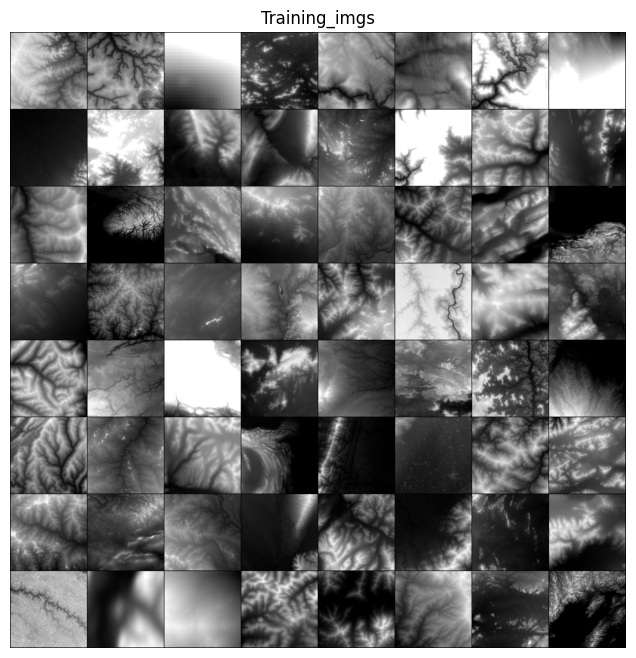

In [11]:
real_batch = next(iter(dataloader))
plt.figure(figsize = (8,8))
plt.axis("off")
plt.title("Training_imgs")
plt.imshow(np.transpose(vutils.make_grid(real_batch.to(device)[:64], padding = 2, normalize=True).cpu(),(1,2,0)), cmap='gray')
plt.show()

In [12]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [13]:
BATCH_SIZE = 64
D_lr = 3e-6
G_lr = 3e-4
FILTER_SIZE = 8

In [14]:
s = 256
s2, s4, s8 = int(s/2), int(s/4), int(s/8)
g_dim = 64
c_dim = 1

In [15]:
class Generator(Module):
    
    
    def __init__(self, batch_size, reuse = False):
        super().__init__()
               
        
        output2_shape = [batch_size, g_dim, s4 , s4 ]
        self.b_conv2 = nn.Parameter(torch.ones(output2_shape[1]) * 0.1)
        self.resize_layer2 = nn.Upsample(size=(output2_shape[2], output2_shape[3]), mode='nearest')
        self.conv2 = nn.Conv2d(in_channels=g_dim, out_channels=s4, kernel_size=(FILTER_SIZE, FILTER_SIZE), padding='same')
        self.batch_norm2 = nn.BatchNorm2d(s4)
        
        output3_shape = [batch_size,g_dim*2, s2 , s2 ]
        self.b_conv3 = nn.Parameter(torch.ones(output3_shape[1]) * 0.1)
        self.resize_layer3 = nn.Upsample(size=(output3_shape[2], output3_shape[3]), mode='nearest')
        self.conv3 = nn.Conv2d(in_channels=g_dim, out_channels=s8, kernel_size=(FILTER_SIZE, FILTER_SIZE), padding='same')
        self.batch_norm3 = nn.BatchNorm2d(s8)
        
        output4_shape = [batch_size, c_dim, s, s]
        self.b_conv4 = nn.Parameter(torch.ones(output4_shape[1]) * 0.1)
        self.resize_layer4 = nn.Upsample(size=(output4_shape[2], output4_shape[3]), mode='nearest')
        self.conv4 = nn.Conv2d(in_channels=s8, out_channels=1, kernel_size=(FILTER_SIZE, FILTER_SIZE), padding='same')
        
    def forward(self, z):
        h0 = torch.reshape(z, [batch_size, 64,s8,s8])
        h0 = LeakyReLU()(h0)
#         print(h0.shape)
        h_conv2 = self.resize_layer2(h0) + self.b_conv2
#         print(h_conv2.shape)
        h_conv2 = self.conv2(h_conv2)
#         print(h_conv2.shape)
        h_conv2 = LeakyReLU()(h_conv2)
        h_conv2 = self.batch_norm2(h_conv2)
        h_conv2 = LeakyReLU()(h_conv2)
        
        h_conv3 = self.resize_layer3(h_conv2) + self.b_conv3
#         print(h_conv3.shape)
        h_conv3 = self.conv3(h_conv3)
#         print(h_conv3.shape)
        h_conv3 = LeakyReLU()(h_conv3)
        h_conv3 = self.batch_norm3(h_conv3)
        h_conv3 = LeakyReLU()(h_conv3)
        
        h_conv4 = self.resize_layer4(h_conv3) + self.b_conv4
#         print(h_conv4.shape)
        h_conv4 = self.conv4(h_conv4)
#         print(h_conv4.shape)
        h_conv4 = LeakyReLU()(h_conv4)
        h_conv4 = Tanh()(h_conv4)
        
        return h_conv4

In [16]:
class Discriminator(Module):
    def __init__(self):
        super().__init__()
        self.leaky_relu = LeakyReLU()
        #256x256x1
        self.conv1 = Conv2d(in_channels=1, out_channels= 8 , kernel_size = 5, stride = 1, padding=1, bias = False)
        #leaky relu here
        #256x256x8
        self.pool1 = AvgPool2d(kernel_size=2, stride = 2, padding = 1)
        #128x128x8
        self.conv2 = Conv2d(in_channels=8, out_channels= 16 , kernel_size = 5, stride = 1, padding=1,  bias = False)
#         LeakyRelu here
        #128x128x16
        self.pool2 = AvgPool2d(kernel_size=2, stride = 2, padding = 1)
        #64x64x16
        #add flatten
        self.dimval = 64*64*16
        
        self.fc1 = Linear(self.dimval, 32,  bias = False)
#         LeakyReLU here
        self.fc2 = Linear(32, 1,  bias = False)
        self.sigmoid = nn.Sigmoid()
        
    def forward(self, inputs):
#         print(inputs.shape)
        x = self.conv1(inputs)
#         print(x.shape)
        x = self.leaky_relu(x)
#         print(x.shape)
        x = self.pool1(x)
#         print(x.shape)
        x = self.conv2(x)
#         print(x.shape)
        x = self.leaky_relu(x)
#         print(x.shape)
        x = self.pool2(x)
#         print(x.shape)
        
        x = torch.reshape(x, [x.shape[0], self.dimval])
        
        x = self.fc1(x)
        x = self.leaky_relu(x)
        
        x =  self.fc2(x)
        output = self.sigmoid(x)
        return output

In [17]:
ngpu = 1
checkpoint = torch.load("/kaggle/input/40-epochs-result/last_GAN.pt")


In [18]:
# Create the generator
netG = Generator(BATCH_SIZE).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
# netG.apply(weights_init)
netG.load_state_dict(checkpoint['Gen_state_dict'])
# Print the model
print(netG)

Generator(
  (resize_layer2): Upsample(size=(64, 64), mode='nearest')
  (conv2): Conv2d(64, 64, kernel_size=(8, 8), stride=(1, 1), padding=same)
  (batch_norm2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (resize_layer3): Upsample(size=(128, 128), mode='nearest')
  (conv3): Conv2d(64, 32, kernel_size=(8, 8), stride=(1, 1), padding=same)
  (batch_norm3): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (resize_layer4): Upsample(size=(256, 256), mode='nearest')
  (conv4): Conv2d(32, 1, kernel_size=(8, 8), stride=(1, 1), padding=same)
)


In [19]:
netD = Discriminator().to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
# netD.apply(weights_init)
netD.load_state_dict(checkpoint['Disc_state_dict'])
# Print the model
print(netD)

Discriminator(
  (leaky_relu): LeakyReLU(negative_slope=0.01)
  (conv1): Conv2d(1, 8, kernel_size=(5, 5), stride=(1, 1), padding=(1, 1), bias=False)
  (pool1): AvgPool2d(kernel_size=2, stride=2, padding=1)
  (conv2): Conv2d(8, 16, kernel_size=(5, 5), stride=(1, 1), padding=(1, 1), bias=False)
  (pool2): AvgPool2d(kernel_size=2, stride=2, padding=1)
  (fc1): Linear(in_features=65536, out_features=32, bias=False)
  (fc2): Linear(in_features=32, out_features=1, bias=False)
  (sigmoid): Sigmoid()
)


In [20]:
criterion = nn.BCELoss()
fixed_noise = torch.randn(batch_size, 256*256, 1,1,device = device)

In [21]:
real_label = 1
fake_label = 0

In [22]:
workers = 2
num_epochs = 70
lr = 0.0002
beta1 = 0.5

In [23]:
optimizerD = optim.Adam(netD.parameters(), lr = D_lr, betas = (beta1, 0.999))
optimizerD.load_state_dict(checkpoint['optimizerD_state_dict'])
optimizerG = optim.Adam(netG.parameters(), lr = G_lr, betas = (beta1, 0.999))
optimizerG.load_state_dict(checkpoint['optimizerG_state_dict'])

In [24]:
device

device(type='cuda', index=0)

In [25]:
!mkdir checkpoints

Starting Training Loop...


/opt/conda/lib/python3.10/site-packages/torch/nn/modules/conv.py:459: UserWarning: Using padding='same' with even kernel lengths and odd dilation may require a zero-padded copy of the input be created (Triggered internally at /usr/local/src/pytorch/aten/src/ATen/native/Convolution.cpp:1003.)
  return F.conv2d(input, weight, bias, self.stride,


[41/70][0/1319]	Loss_D: 1.0326	Loss_G: 0.6791	D(x): 0.8071	D(G(z)): 0.5244 / 0.5143
[41/70][50/1319]	Loss_D: 1.1117	Loss_G: 0.6217	D(x): 0.7800	D(G(z)): 0.5511 / 0.5442
[41/70][100/1319]	Loss_D: 1.1019	Loss_G: 0.6083	D(x): 0.7852	D(G(z)): 0.5523 / 0.5498
[41/70][150/1319]	Loss_D: 0.9602	Loss_G: 0.7161	D(x): 0.8050	D(G(z)): 0.4965 / 0.4923
[41/70][200/1319]	Loss_D: 1.1545	Loss_G: 0.5922	D(x): 0.7850	D(G(z)): 0.5643 / 0.5637
[41/70][250/1319]	Loss_D: 1.0800	Loss_G: 0.6425	D(x): 0.7771	D(G(z)): 0.5318 / 0.5326
[41/70][300/1319]	Loss_D: 0.9391	Loss_G: 0.7289	D(x): 0.8228	D(G(z)): 0.4976 / 0.4888
[41/70][350/1319]	Loss_D: 0.9606	Loss_G: 0.6877	D(x): 0.8233	D(G(z)): 0.5136 / 0.5087
[41/70][400/1319]	Loss_D: 1.0064	Loss_G: 0.6376	D(x): 0.8311	D(G(z)): 0.5433 / 0.5325
[41/70][450/1319]	Loss_D: 0.9631	Loss_G: 0.7073	D(x): 0.8086	D(G(z)): 0.5053 / 0.4964
[41/70][500/1319]	Loss_D: 0.9783	Loss_G: 0.6957	D(x): 0.8043	D(G(z)): 0.5058 / 0.5021
[41/70][550/1319]	Loss_D: 1.1190	Loss_G: 0.6472	D(x): 0.7

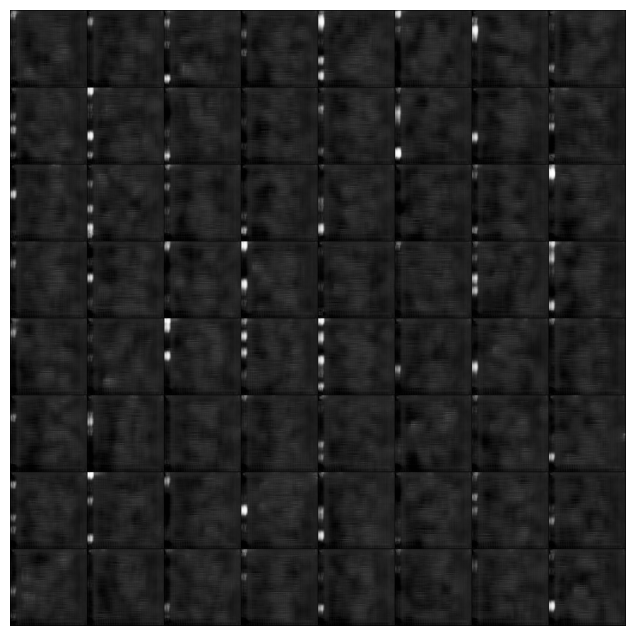

[44/70][50/1319]	Loss_D: 1.0087	Loss_G: 0.6463	D(x): 0.8405	D(G(z)): 0.5384 / 0.5351
[44/70][100/1319]	Loss_D: 1.2307	Loss_G: 0.6014	D(x): 0.8015	D(G(z)): 0.5734 / 0.5733


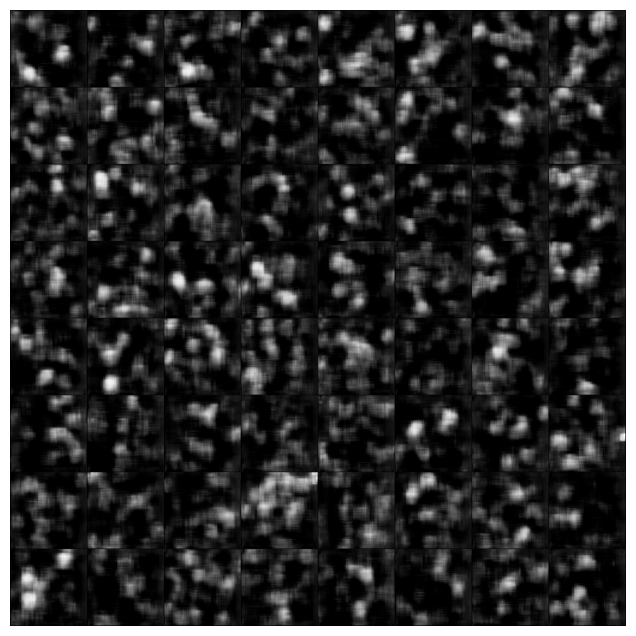

[44/70][150/1319]	Loss_D: 1.1589	Loss_G: 0.6555	D(x): 0.7927	D(G(z)): 0.5470 / 0.5462
[44/70][200/1319]	Loss_D: 0.9548	Loss_G: 0.7281	D(x): 0.8104	D(G(z)): 0.5015 / 0.4906


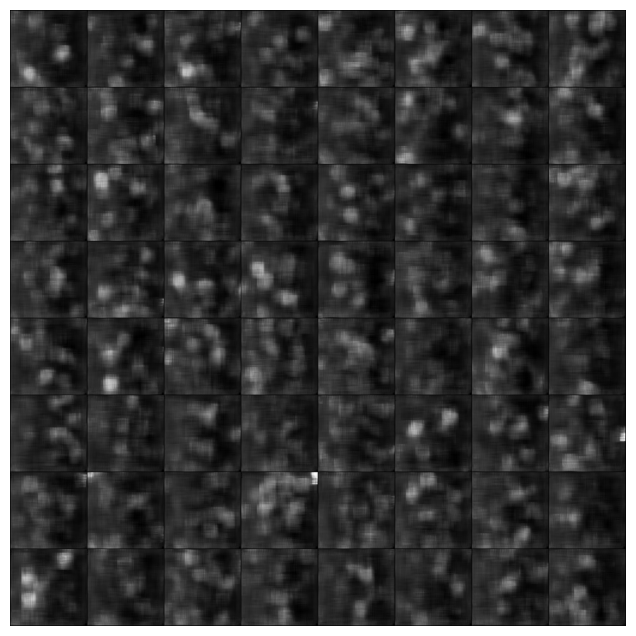

[44/70][250/1319]	Loss_D: 1.0448	Loss_G: 0.7104	D(x): 0.7486	D(G(z)): 0.4922 / 0.4918
[44/70][300/1319]	Loss_D: 1.0380	Loss_G: 0.6728	D(x): 0.7803	D(G(z)): 0.5158 / 0.5117


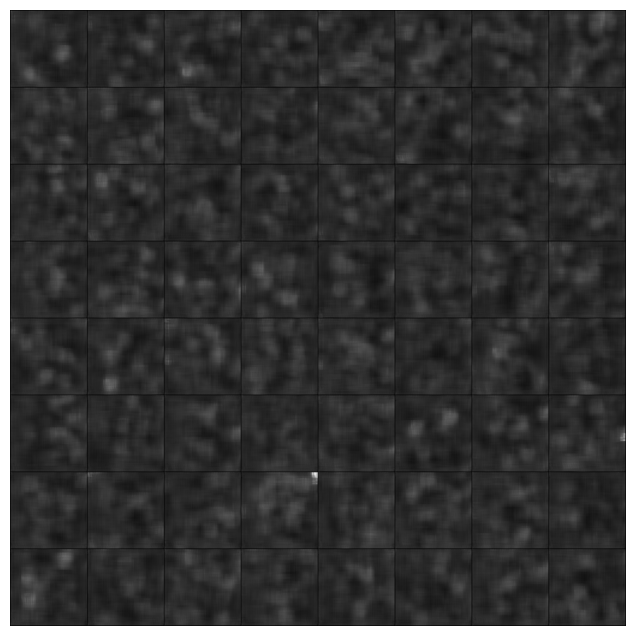

[44/70][350/1319]	Loss_D: 1.0687	Loss_G: 0.6513	D(x): 0.8030	D(G(z)): 0.5364 / 0.5334
[44/70][400/1319]	Loss_D: 0.9912	Loss_G: 0.6658	D(x): 0.8207	D(G(z)): 0.5281 / 0.5199


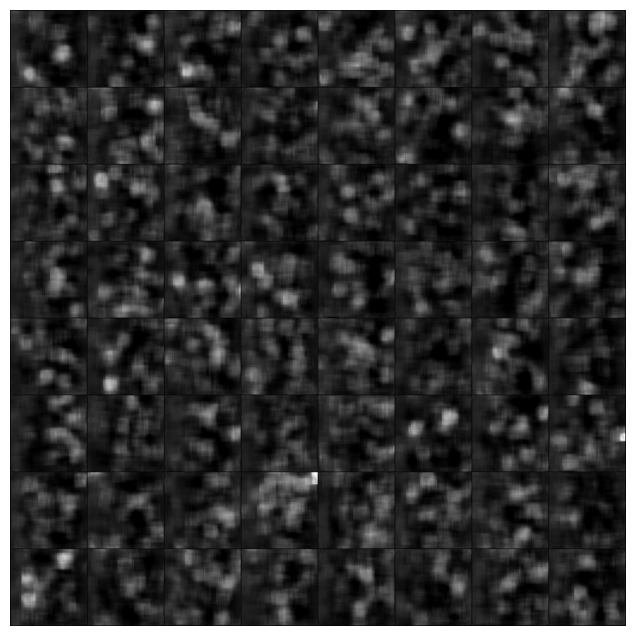

[44/70][450/1319]	Loss_D: 1.1404	Loss_G: 0.6713	D(x): 0.7387	D(G(z)): 0.5172 / 0.5216
[44/70][500/1319]	Loss_D: 1.0048	Loss_G: 0.6736	D(x): 0.8077	D(G(z)): 0.5173 / 0.5170


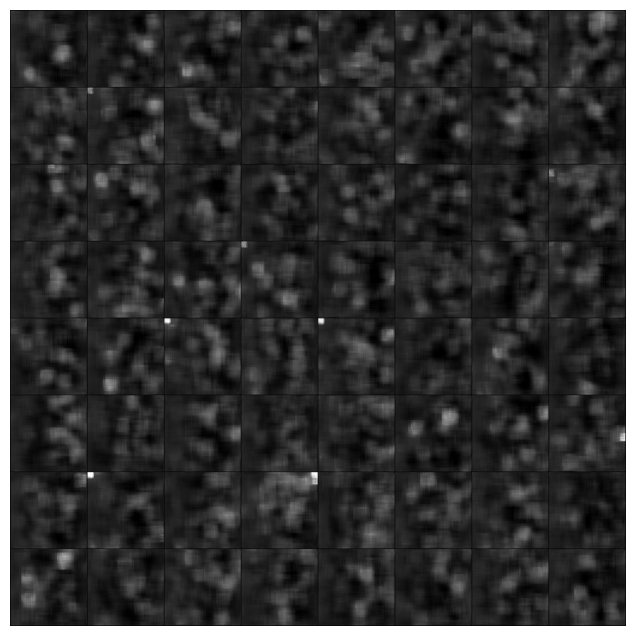

[44/70][550/1319]	Loss_D: 1.0804	Loss_G: 0.6463	D(x): 0.7627	D(G(z)): 0.5258 / 0.5281
[44/70][600/1319]	Loss_D: 1.0016	Loss_G: 0.7031	D(x): 0.7673	D(G(z)): 0.4905 / 0.4981


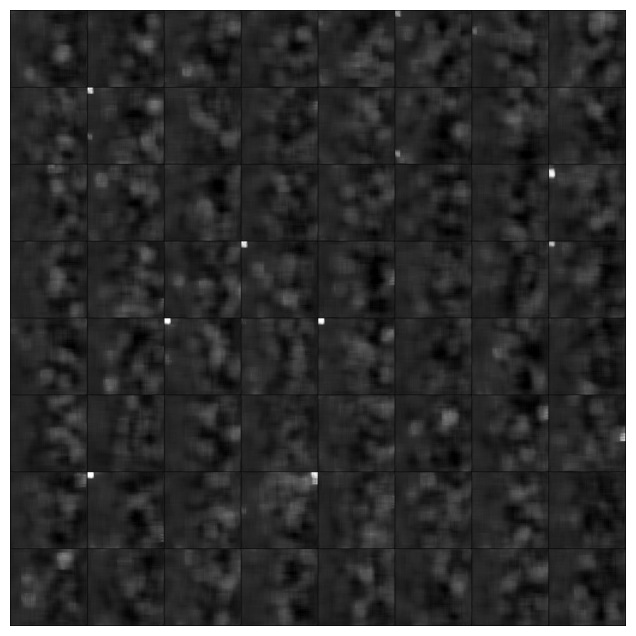

[44/70][650/1319]	Loss_D: 1.0449	Loss_G: 0.6708	D(x): 0.7616	D(G(z)): 0.5063 / 0.5143
[44/70][700/1319]	Loss_D: 0.9725	Loss_G: 0.7147	D(x): 0.7942	D(G(z)): 0.4980 / 0.4938


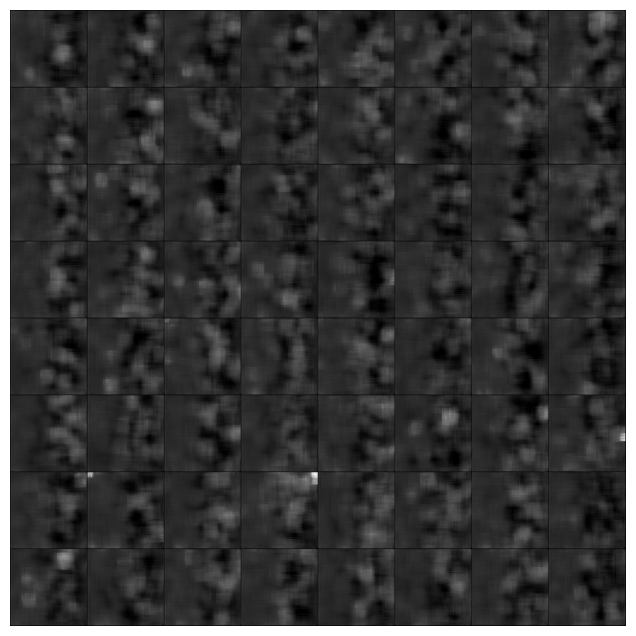

[44/70][750/1319]	Loss_D: 1.0790	Loss_G: 0.6831	D(x): 0.7338	D(G(z)): 0.5051 / 0.5110
[44/70][800/1319]	Loss_D: 1.0250	Loss_G: 0.6906	D(x): 0.7778	D(G(z)): 0.5019 / 0.5083


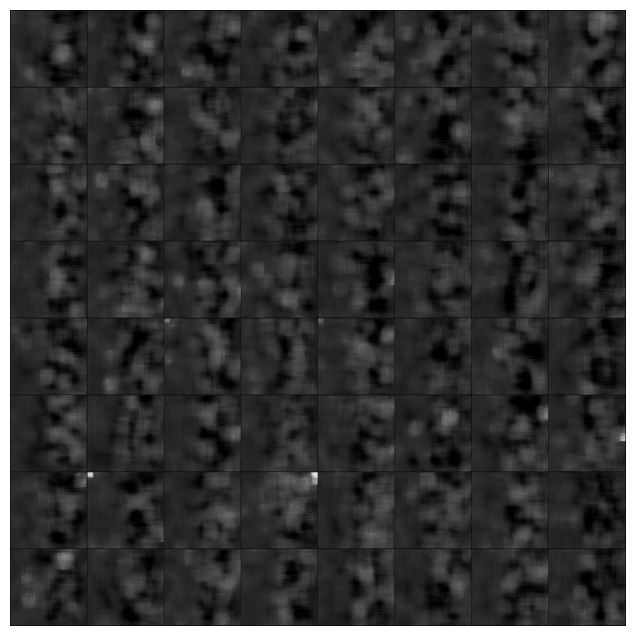

[44/70][850/1319]	Loss_D: 1.0438	Loss_G: 0.6868	D(x): 0.7704	D(G(z)): 0.5076 / 0.5085
[44/70][900/1319]	Loss_D: 1.1315	Loss_G: 0.6594	D(x): 0.7162	D(G(z)): 0.5104 / 0.5236


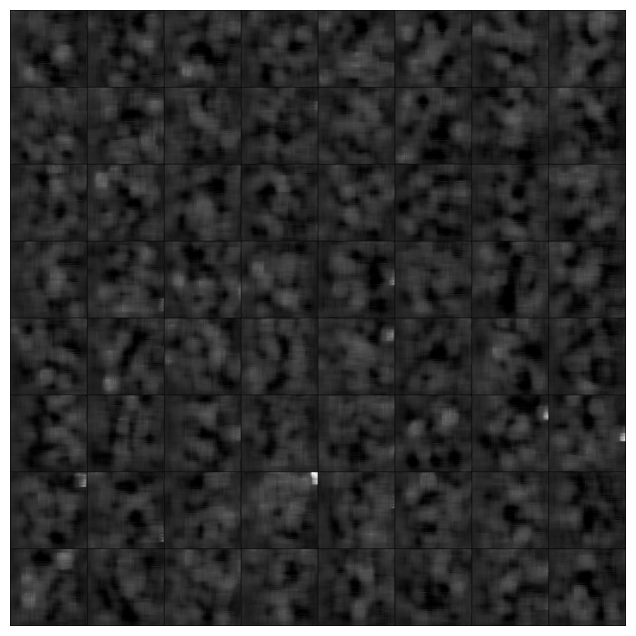

[44/70][950/1319]	Loss_D: 1.0454	Loss_G: 0.6804	D(x): 0.7839	D(G(z)): 0.5192 / 0.5171
[44/70][1000/1319]	Loss_D: 1.0177	Loss_G: 0.6884	D(x): 0.7917	D(G(z)): 0.5146 / 0.5114


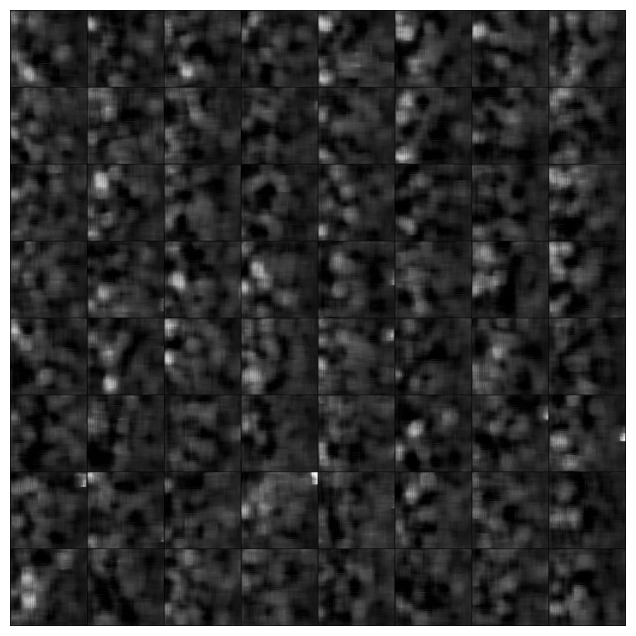

[44/70][1050/1319]	Loss_D: 1.0333	Loss_G: 0.6509	D(x): 0.8097	D(G(z)): 0.5307 / 0.5300
[44/70][1100/1319]	Loss_D: 1.0955	Loss_G: 0.6686	D(x): 0.7493	D(G(z)): 0.5194 / 0.5175


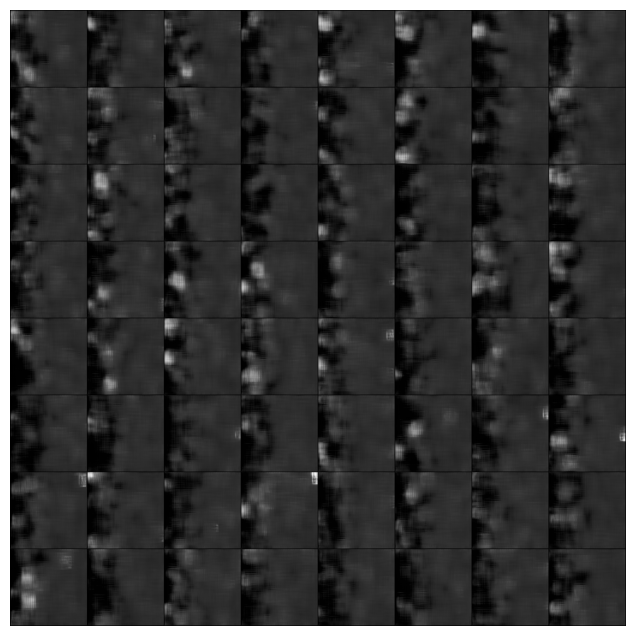

[44/70][1150/1319]	Loss_D: 1.0824	Loss_G: 0.6213	D(x): 0.7887	D(G(z)): 0.5404 / 0.5431
[44/70][1200/1319]	Loss_D: 1.0873	Loss_G: 0.6929	D(x): 0.7697	D(G(z)): 0.5195 / 0.5079


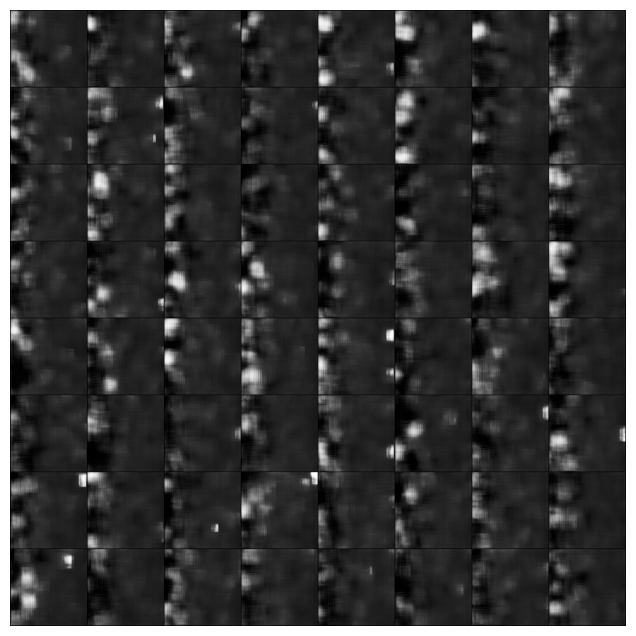

[44/70][1250/1319]	Loss_D: 1.0382	Loss_G: 0.6614	D(x): 0.8085	D(G(z)): 0.5354 / 0.5299
[44/70][1300/1319]	Loss_D: 1.0905	Loss_G: 0.6416	D(x): 0.7814	D(G(z)): 0.5376 / 0.5350


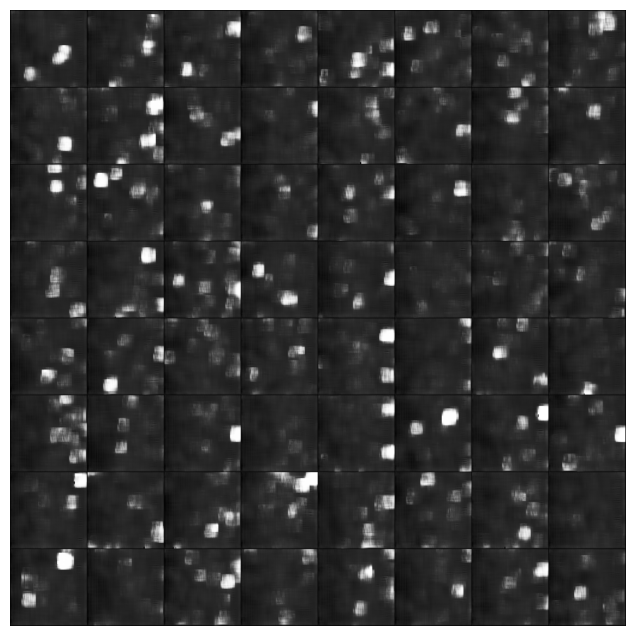

[45/70][0/1319]	Loss_D: 0.9579	Loss_G: 0.7215	D(x): 0.8281	D(G(z)): 0.5095 / 0.4977
[45/70][50/1319]	Loss_D: 0.9590	Loss_G: 0.7218	D(x): 0.7890	D(G(z)): 0.4925 / 0.4887
[45/70][100/1319]	Loss_D: 0.9365	Loss_G: 0.7511	D(x): 0.7889	D(G(z)): 0.4765 / 0.4762
[45/70][150/1319]	Loss_D: 1.1188	Loss_G: 0.5952	D(x): 0.8346	D(G(z)): 0.5678 / 0.5669
[45/70][200/1319]	Loss_D: 1.0740	Loss_G: 0.6663	D(x): 0.8334	D(G(z)): 0.5406 / 0.5320
[45/70][250/1319]	Loss_D: 1.0649	Loss_G: 0.6673	D(x): 0.7267	D(G(z)): 0.4945 / 0.5136
[45/70][300/1319]	Loss_D: 0.9776	Loss_G: 0.7265	D(x): 0.7831	D(G(z)): 0.4935 / 0.4879
[45/70][350/1319]	Loss_D: 1.0503	Loss_G: 0.6657	D(x): 0.7785	D(G(z)): 0.5237 / 0.5212
[45/70][400/1319]	Loss_D: 0.9740	Loss_G: 0.6812	D(x): 0.8251	D(G(z)): 0.5224 / 0.5101
[45/70][450/1319]	Loss_D: 1.1496	Loss_G: 0.6617	D(x): 0.7097	D(G(z)): 0.5101 / 0.5203
[45/70][500/1319]	Loss_D: 0.9828	Loss_G: 0.7412	D(x): 0.7593	D(G(z)): 0.4758 / 0.4787
[45/70][550/1319]	Loss_D: 1.0064	Loss_G: 0.6947	D(x): 0.7

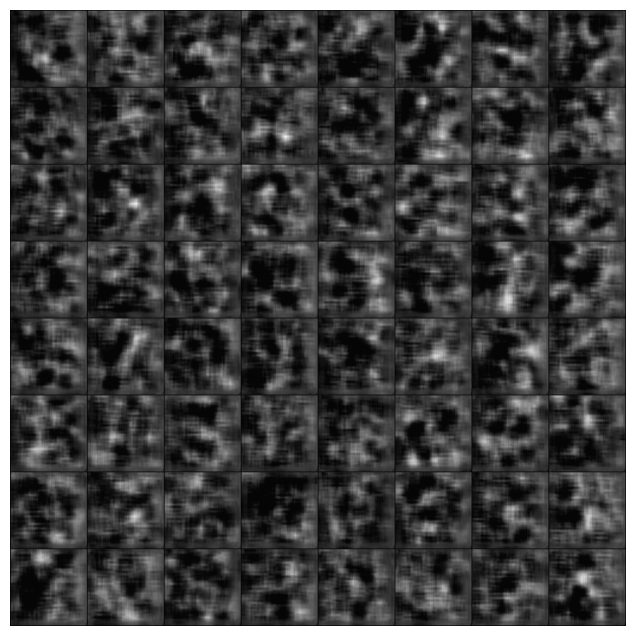

[48/70][50/1319]	Loss_D: 1.1200	Loss_G: 0.6222	D(x): 0.7700	D(G(z)): 0.5407 / 0.5473
[48/70][100/1319]	Loss_D: 0.9360	Loss_G: 0.7195	D(x): 0.8076	D(G(z)): 0.4884 / 0.4896


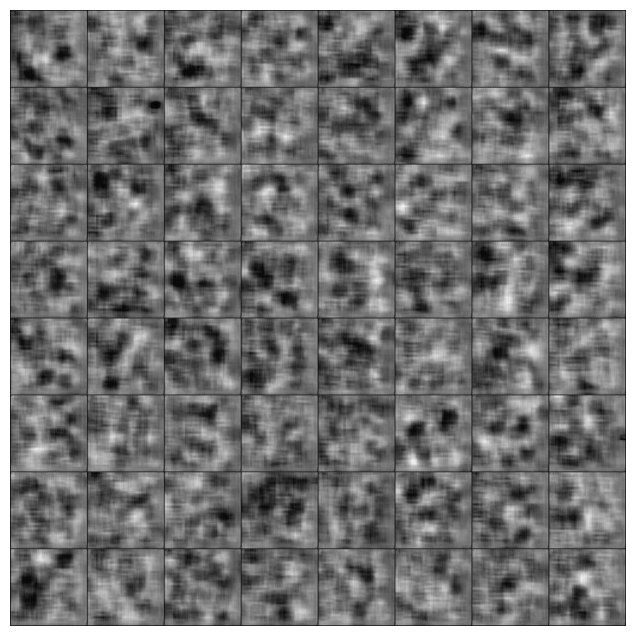

[48/70][150/1319]	Loss_D: 0.9862	Loss_G: 0.7340	D(x): 0.7539	D(G(z)): 0.4776 / 0.4813
[48/70][200/1319]	Loss_D: 0.9740	Loss_G: 0.7176	D(x): 0.7864	D(G(z)): 0.4870 / 0.4902


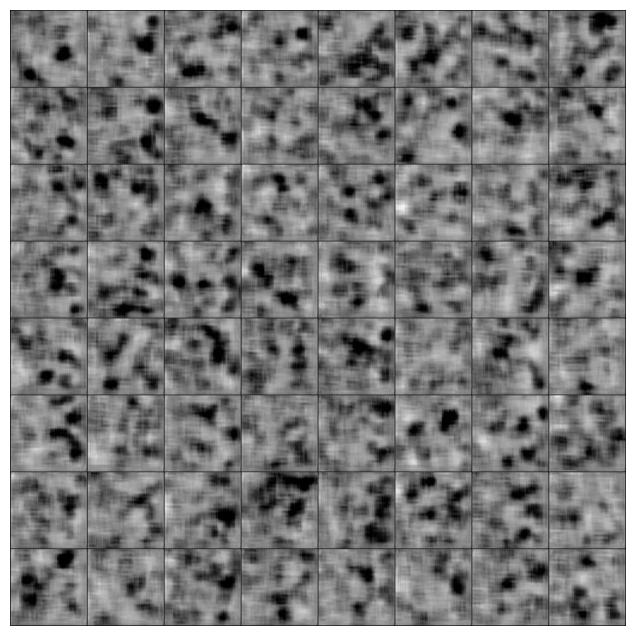

[48/70][250/1319]	Loss_D: 1.0186	Loss_G: 0.6574	D(x): 0.8246	D(G(z)): 0.5296 / 0.5259
[48/70][300/1319]	Loss_D: 1.0981	Loss_G: 0.6218	D(x): 0.7946	D(G(z)): 0.5475 / 0.5482


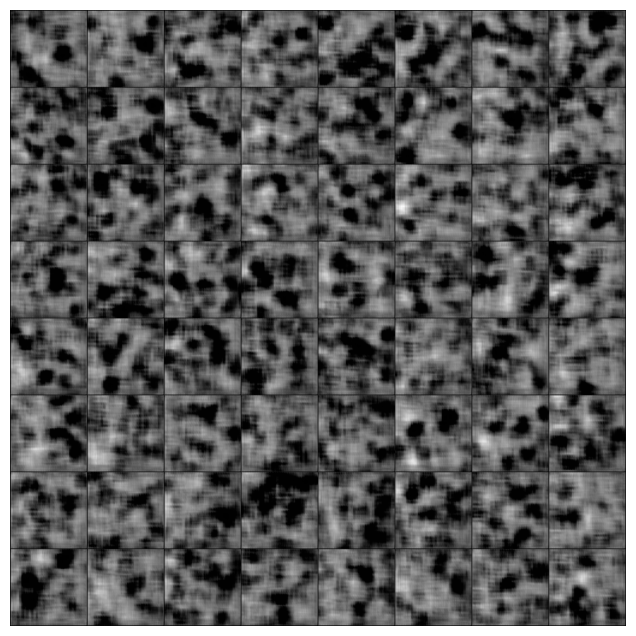

[48/70][350/1319]	Loss_D: 1.0199	Loss_G: 0.6314	D(x): 0.8394	D(G(z)): 0.5440 / 0.5388
[48/70][400/1319]	Loss_D: 0.9192	Loss_G: 0.7438	D(x): 0.8227	D(G(z)): 0.4918 / 0.4820


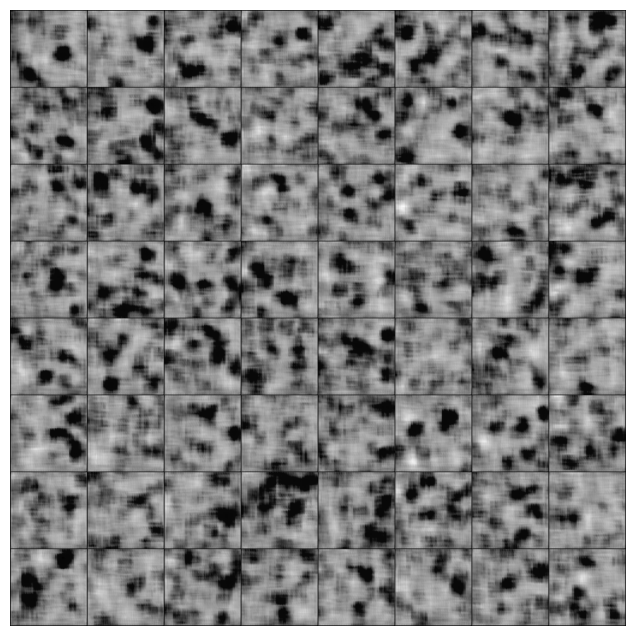

[48/70][450/1319]	Loss_D: 1.0226	Loss_G: 0.6459	D(x): 0.8190	D(G(z)): 0.5344 / 0.5302
[48/70][500/1319]	Loss_D: 1.0342	Loss_G: 0.6707	D(x): 0.7718	D(G(z)): 0.5078 / 0.5149


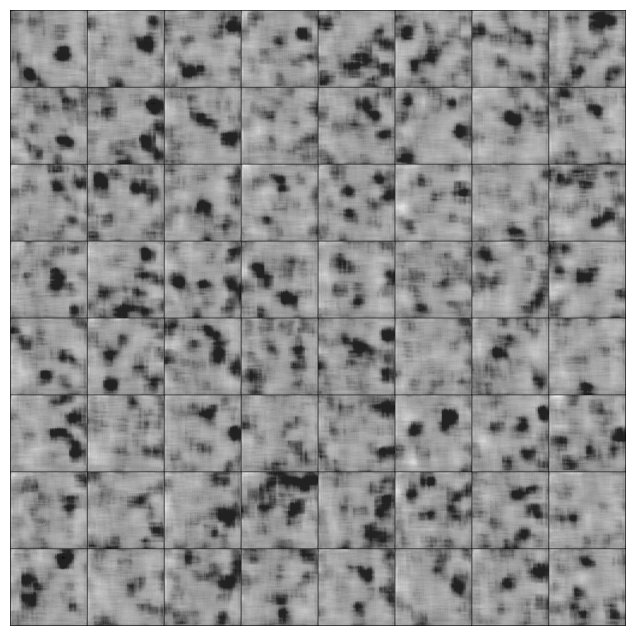

[48/70][550/1319]	Loss_D: 0.9403	Loss_G: 0.7114	D(x): 0.8074	D(G(z)): 0.4931 / 0.4956
[48/70][600/1319]	Loss_D: 0.9876	Loss_G: 0.6816	D(x): 0.8070	D(G(z)): 0.5119 / 0.5105


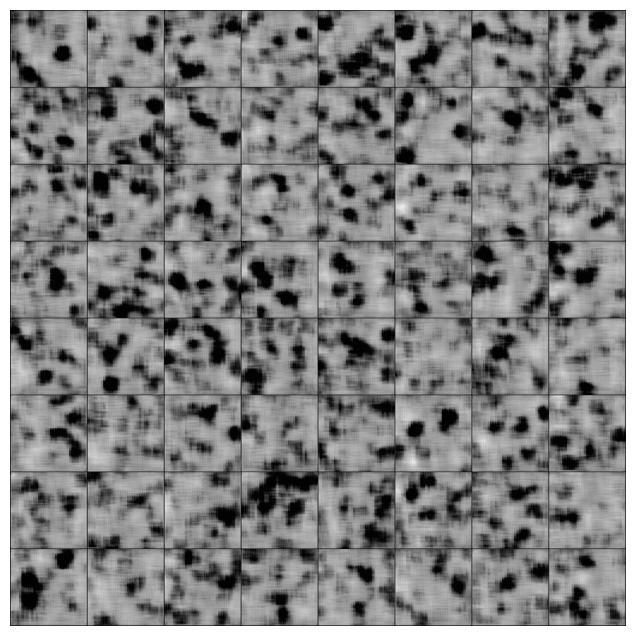

[48/70][650/1319]	Loss_D: 0.9339	Loss_G: 0.6803	D(x): 0.8445	D(G(z)): 0.5152 / 0.5124
[48/70][700/1319]	Loss_D: 1.0797	Loss_G: 0.6648	D(x): 0.7467	D(G(z)): 0.5143 / 0.5208


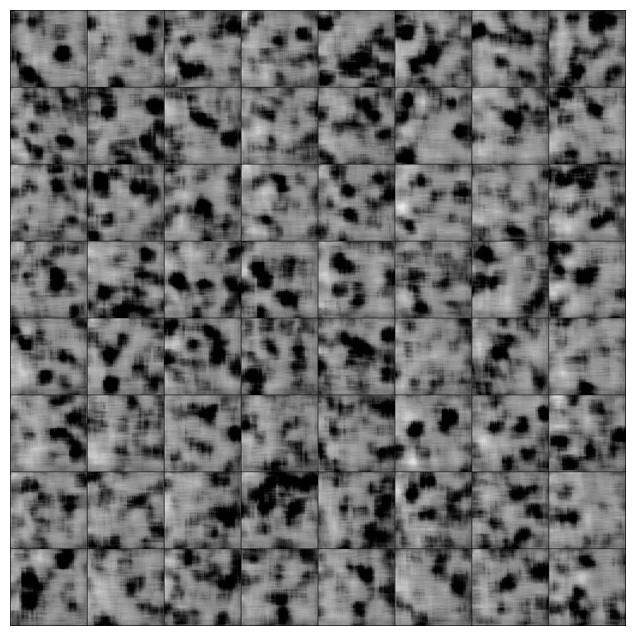

[48/70][750/1319]	Loss_D: 0.9818	Loss_G: 0.7091	D(x): 0.7883	D(G(z)): 0.5007 / 0.4956
[48/70][800/1319]	Loss_D: 1.0015	Loss_G: 0.7208	D(x): 0.7778	D(G(z)): 0.4887 / 0.4905


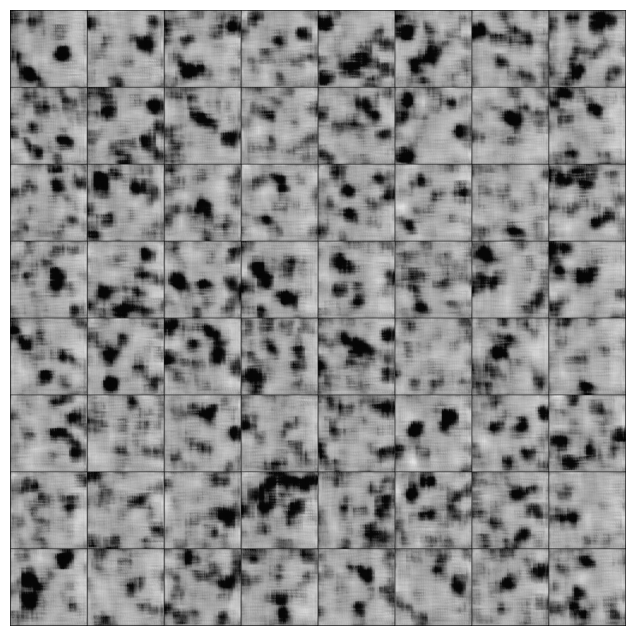

[48/70][850/1319]	Loss_D: 1.0127	Loss_G: 0.6777	D(x): 0.7933	D(G(z)): 0.5098 / 0.5165
[48/70][900/1319]	Loss_D: 0.9923	Loss_G: 0.6339	D(x): 0.8793	D(G(z)): 0.5549 / 0.5387


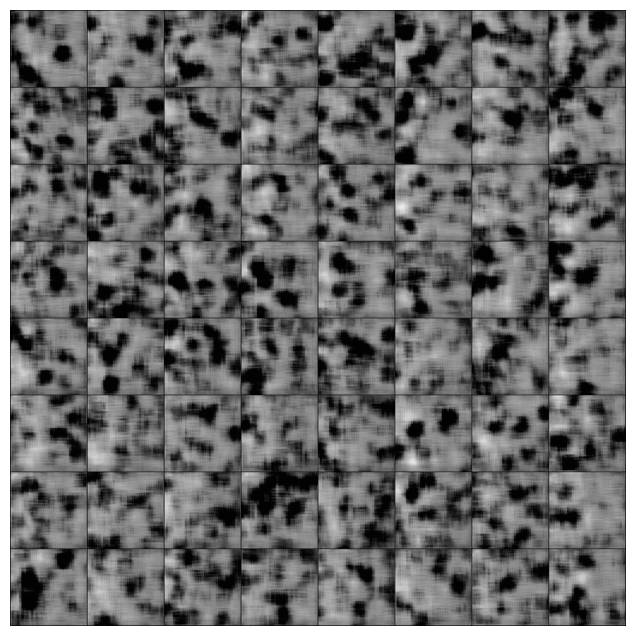

[48/70][950/1319]	Loss_D: 0.9801	Loss_G: 0.6591	D(x): 0.8484	D(G(z)): 0.5343 / 0.5266
[48/70][1000/1319]	Loss_D: 1.0199	Loss_G: 0.6904	D(x): 0.7807	D(G(z)): 0.5077 / 0.5056


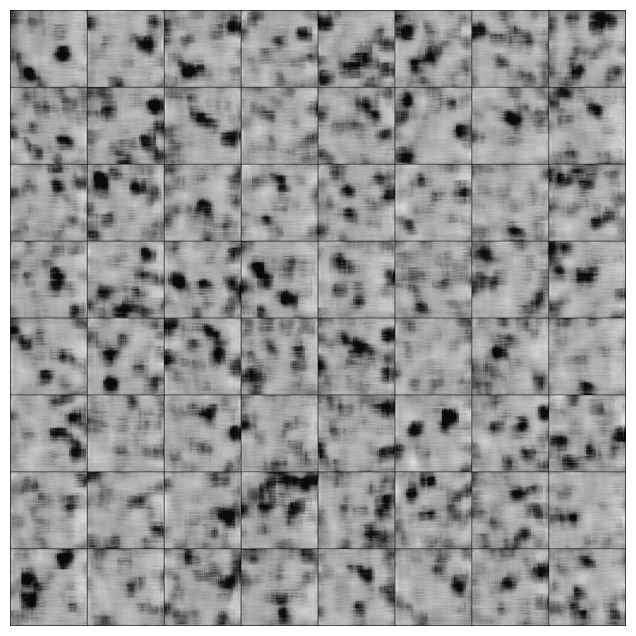

[48/70][1050/1319]	Loss_D: 1.0207	Loss_G: 0.6602	D(x): 0.8210	D(G(z)): 0.5296 / 0.5239
[48/70][1100/1319]	Loss_D: 0.9861	Loss_G: 0.6734	D(x): 0.8151	D(G(z)): 0.5130 / 0.5156


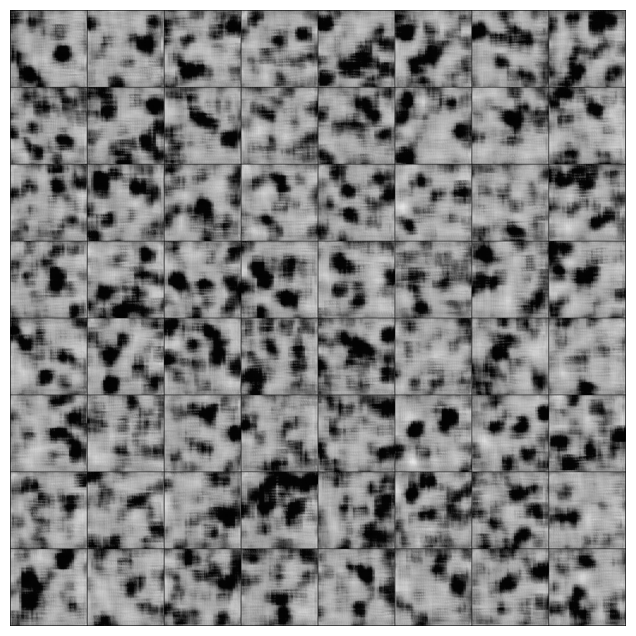

[48/70][1150/1319]	Loss_D: 0.9457	Loss_G: 0.7020	D(x): 0.8292	D(G(z)): 0.5051 / 0.5029
[48/70][1200/1319]	Loss_D: 0.9692	Loss_G: 0.7637	D(x): 0.7894	D(G(z)): 0.4784 / 0.4713


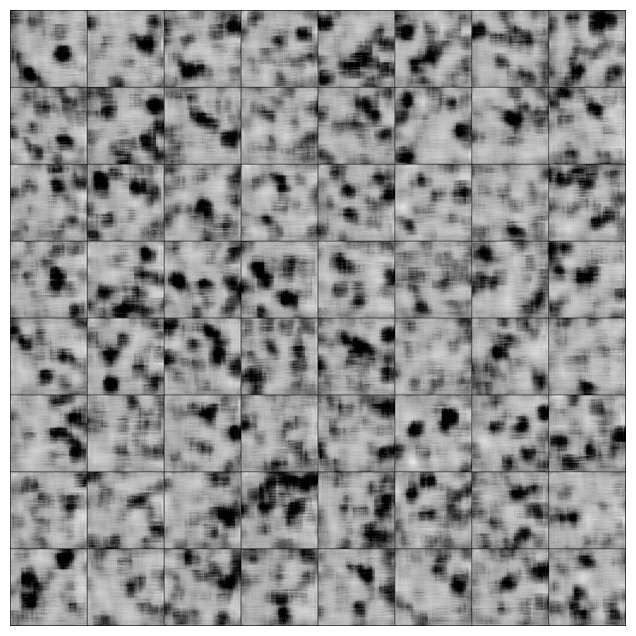

[48/70][1250/1319]	Loss_D: 0.9479	Loss_G: 0.7342	D(x): 0.7952	D(G(z)): 0.4820 / 0.4855
[48/70][1300/1319]	Loss_D: 0.9748	Loss_G: 0.6840	D(x): 0.8140	D(G(z)): 0.5134 / 0.5104


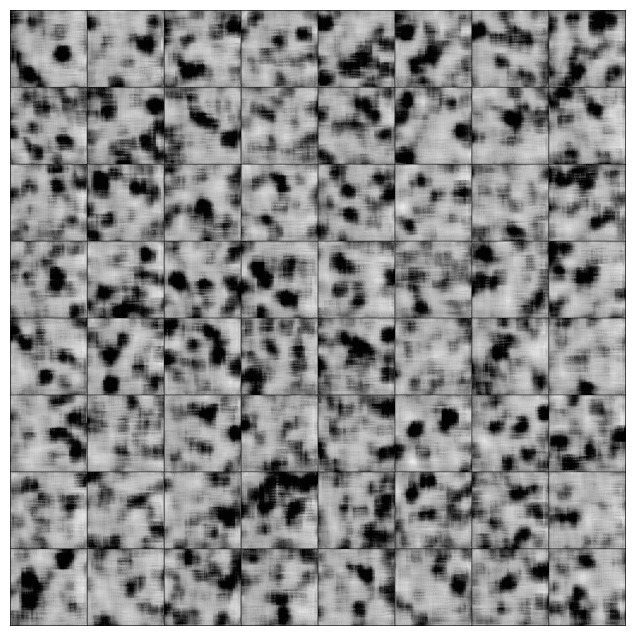

[49/70][0/1319]	Loss_D: 1.0249	Loss_G: 0.6851	D(x): 0.7742	D(G(z)): 0.4976 / 0.5086
[49/70][50/1319]	Loss_D: 1.0737	Loss_G: 0.6489	D(x): 0.7961	D(G(z)): 0.5379 / 0.5298
[49/70][100/1319]	Loss_D: 0.9208	Loss_G: 0.7484	D(x): 0.8142	D(G(z)): 0.4747 / 0.4758
[49/70][150/1319]	Loss_D: 1.0652	Loss_G: 0.6481	D(x): 0.8020	D(G(z)): 0.5330 / 0.5308
[49/70][200/1319]	Loss_D: 1.0422	Loss_G: 0.6967	D(x): 0.7557	D(G(z)): 0.4931 / 0.5040
[49/70][250/1319]	Loss_D: 1.0290	Loss_G: 0.6332	D(x): 0.8044	D(G(z)): 0.5290 / 0.5376
[49/70][300/1319]	Loss_D: 1.0105	Loss_G: 0.7454	D(x): 0.7473	D(G(z)): 0.4705 / 0.4795
[49/70][350/1319]	Loss_D: 0.9312	Loss_G: 0.7099	D(x): 0.8398	D(G(z)): 0.5119 / 0.4993
[49/70][400/1319]	Loss_D: 1.0237	Loss_G: 0.6735	D(x): 0.7852	D(G(z)): 0.5068 / 0.5179
[49/70][450/1319]	Loss_D: 0.9668	Loss_G: 0.6965	D(x): 0.8092	D(G(z)): 0.5057 / 0.5032
[49/70][500/1319]	Loss_D: 0.9805	Loss_G: 0.6783	D(x): 0.8228	D(G(z)): 0.5236 / 0.5127
[49/70][550/1319]	Loss_D: 1.0384	Loss_G: 0.6664	D(x): 0.7

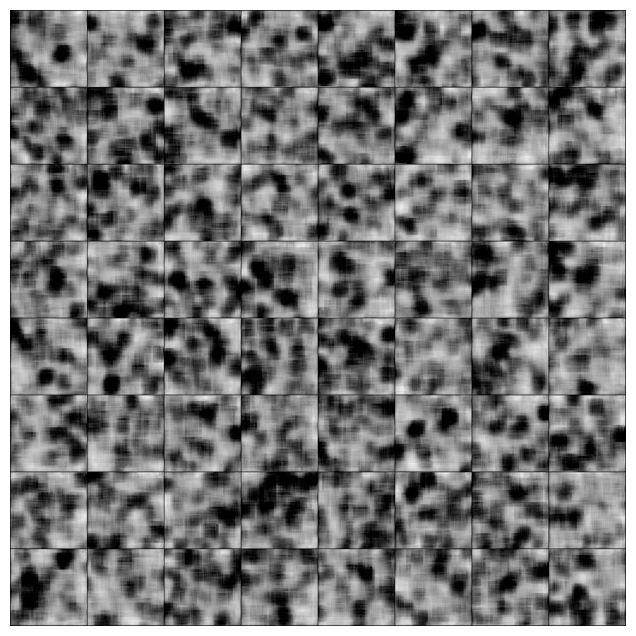

[52/70][50/1319]	Loss_D: 1.0389	Loss_G: 0.6744	D(x): 0.7814	D(G(z)): 0.5098 / 0.5117
[52/70][100/1319]	Loss_D: 1.2169	Loss_G: 0.5993	D(x): 0.7637	D(G(z)): 0.5815 / 0.5549


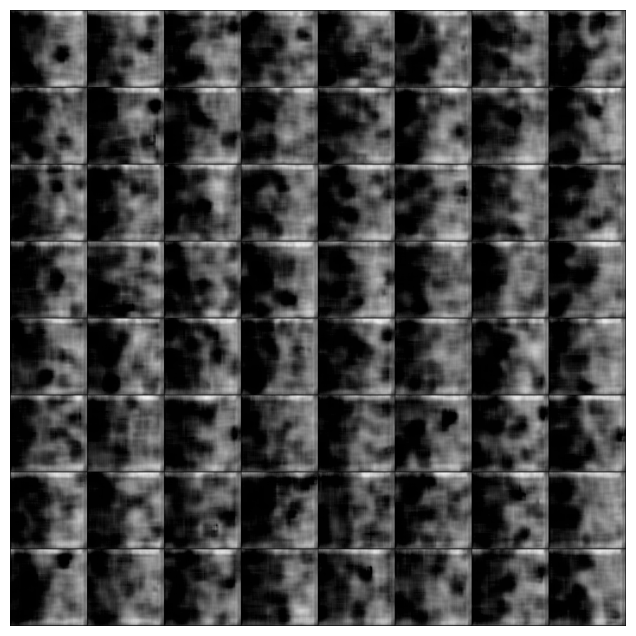

[52/70][150/1319]	Loss_D: 0.7908	Loss_G: 0.8065	D(x): 0.8750	D(G(z)): 0.4655 / 0.4525
[52/70][200/1319]	Loss_D: 0.9602	Loss_G: 0.7140	D(x): 0.8088	D(G(z)): 0.4936 / 0.4969


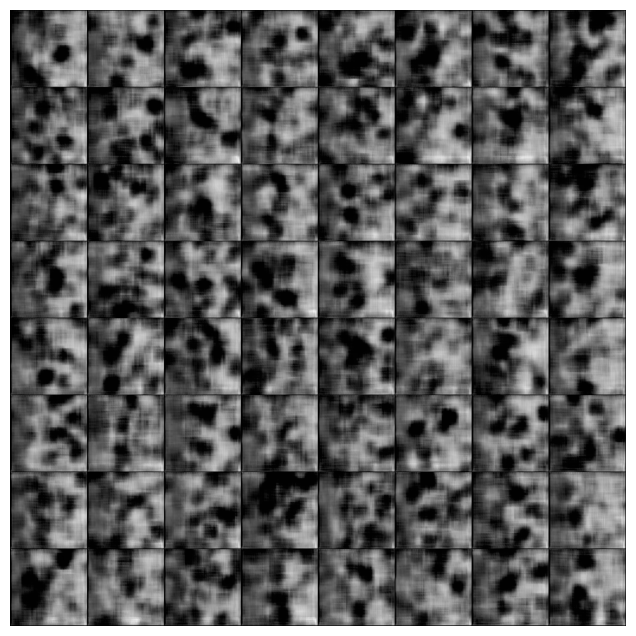

[52/70][250/1319]	Loss_D: 1.0360	Loss_G: 0.6451	D(x): 0.8127	D(G(z)): 0.5356 / 0.5327
[52/70][300/1319]	Loss_D: 1.0734	Loss_G: 0.6764	D(x): 0.7947	D(G(z)): 0.5332 / 0.5202


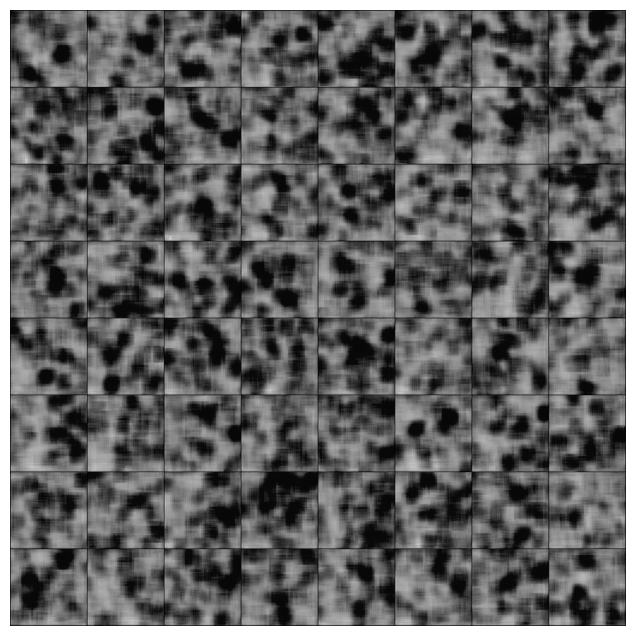

[52/70][350/1319]	Loss_D: 0.9194	Loss_G: 0.7904	D(x): 0.7757	D(G(z)): 0.4557 / 0.4539
[52/70][400/1319]	Loss_D: 0.9948	Loss_G: 0.6745	D(x): 0.8043	D(G(z)): 0.5097 / 0.5181


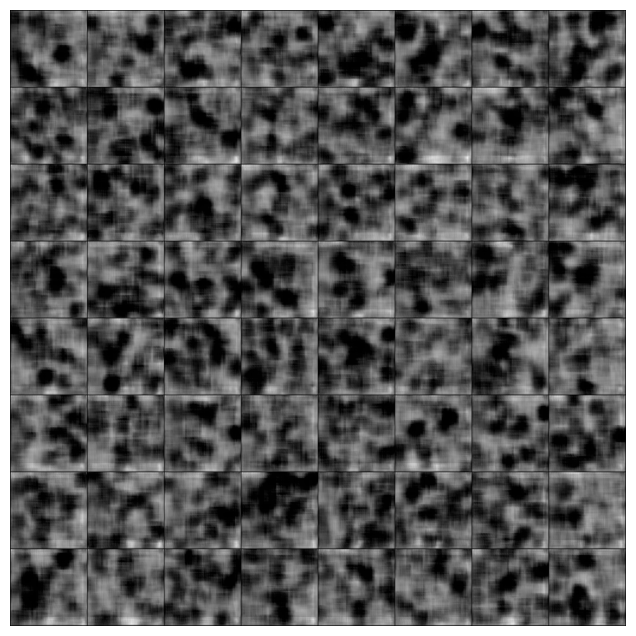

[52/70][450/1319]	Loss_D: 0.8958	Loss_G: 0.6919	D(x): 0.8698	D(G(z)): 0.5117 / 0.5081
[52/70][500/1319]	Loss_D: 0.9681	Loss_G: 0.7099	D(x): 0.8016	D(G(z)): 0.4988 / 0.4978


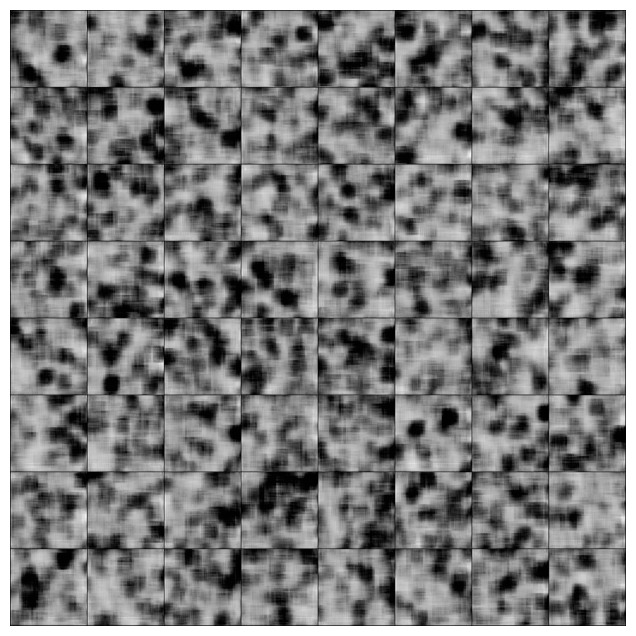

[52/70][550/1319]	Loss_D: 1.0113	Loss_G: 0.6537	D(x): 0.8218	D(G(z)): 0.5294 / 0.5263
[52/70][600/1319]	Loss_D: 0.9611	Loss_G: 0.6945	D(x): 0.8355	D(G(z)): 0.5152 / 0.5045


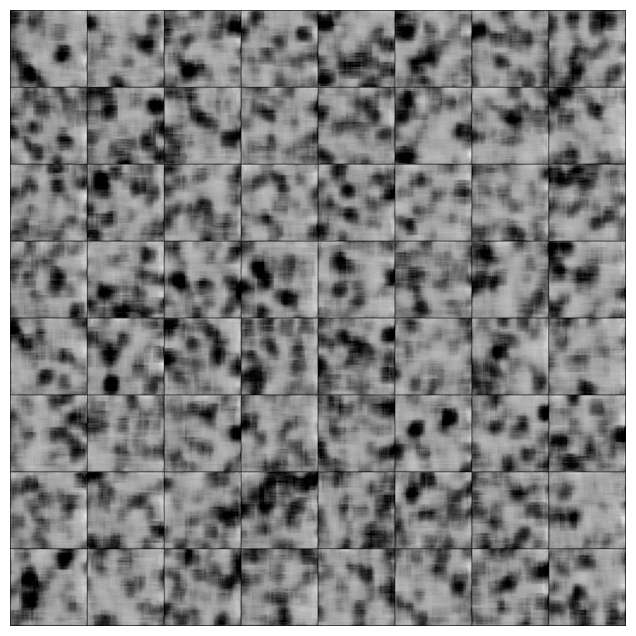

[52/70][650/1319]	Loss_D: 0.9912	Loss_G: 0.6595	D(x): 0.8131	D(G(z)): 0.5186 / 0.5218
[52/70][700/1319]	Loss_D: 1.0301	Loss_G: 0.6791	D(x): 0.7916	D(G(z)): 0.5147 / 0.5186


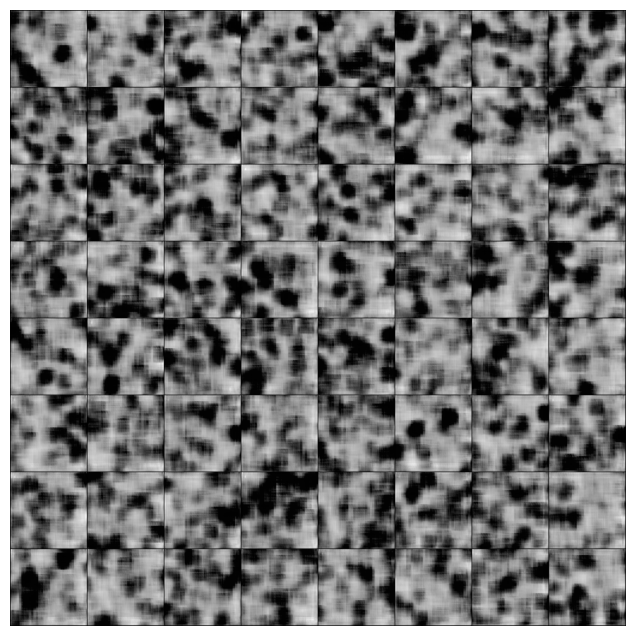

[52/70][750/1319]	Loss_D: 1.0772	Loss_G: 0.6821	D(x): 0.7802	D(G(z)): 0.5150 / 0.5144
[52/70][800/1319]	Loss_D: 0.9280	Loss_G: 0.6813	D(x): 0.8553	D(G(z)): 0.5210 / 0.5105


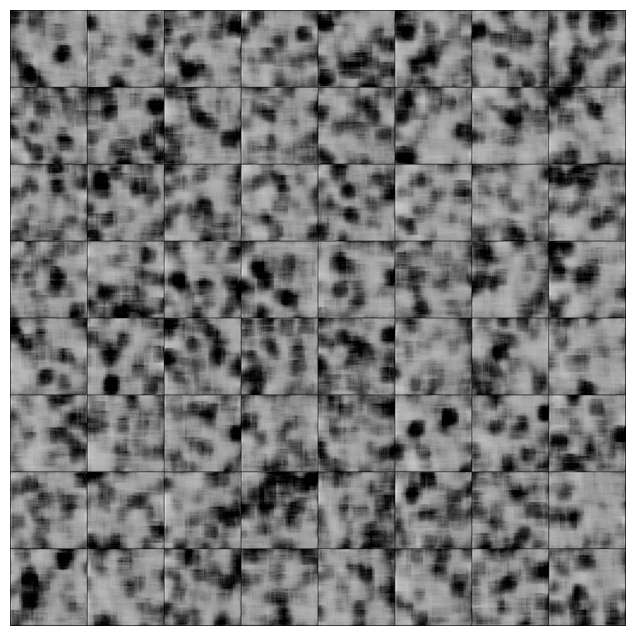

[52/70][850/1319]	Loss_D: 0.9661	Loss_G: 0.6933	D(x): 0.8094	D(G(z)): 0.5009 / 0.5082
[52/70][900/1319]	Loss_D: 0.8796	Loss_G: 0.7226	D(x): 0.8421	D(G(z)): 0.4911 / 0.4857


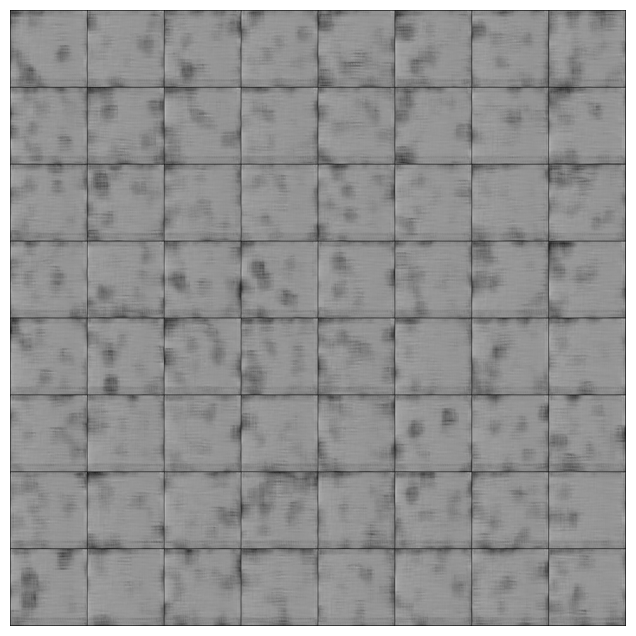

[52/70][950/1319]	Loss_D: 0.9970	Loss_G: 0.6880	D(x): 0.8253	D(G(z)): 0.5148 / 0.5125
[52/70][1000/1319]	Loss_D: 0.9359	Loss_G: 0.7037	D(x): 0.8401	D(G(z)): 0.5029 / 0.5008


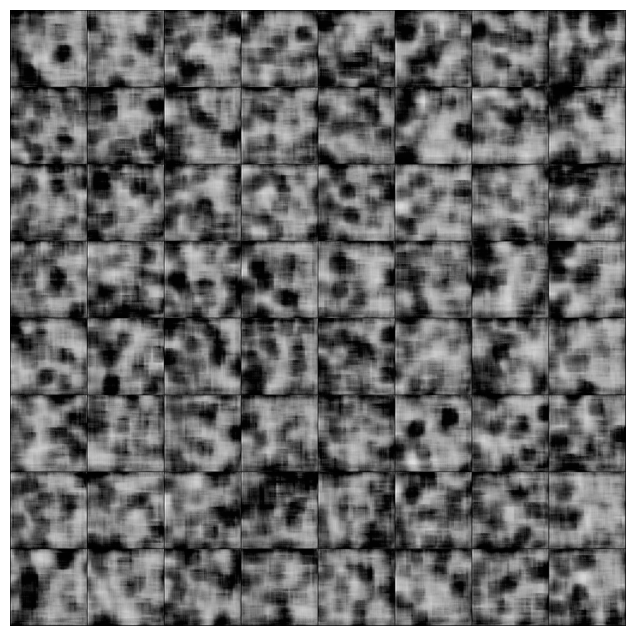

[52/70][1050/1319]	Loss_D: 1.1634	Loss_G: 0.6003	D(x): 0.7997	D(G(z)): 0.5701 / 0.5591
[52/70][1100/1319]	Loss_D: 0.8971	Loss_G: 0.7802	D(x): 0.8238	D(G(z)): 0.4744 / 0.4653


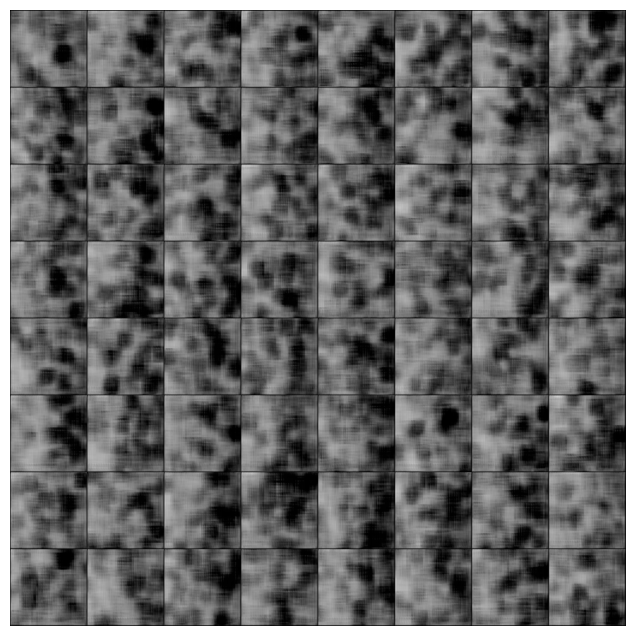

[52/70][1150/1319]	Loss_D: 1.0816	Loss_G: 0.6767	D(x): 0.7814	D(G(z)): 0.5240 / 0.5101
[52/70][1200/1319]	Loss_D: 1.0003	Loss_G: 0.6534	D(x): 0.8594	D(G(z)): 0.5534 / 0.5233


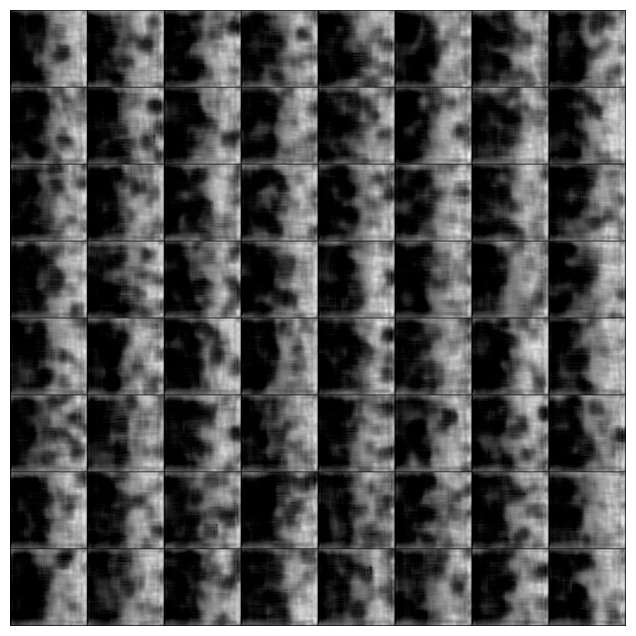

[52/70][1250/1319]	Loss_D: 0.9494	Loss_G: 0.7441	D(x): 0.8092	D(G(z)): 0.4901 / 0.4833
[52/70][1300/1319]	Loss_D: 1.0240	Loss_G: 0.6582	D(x): 0.8145	D(G(z)): 0.5326 / 0.5272


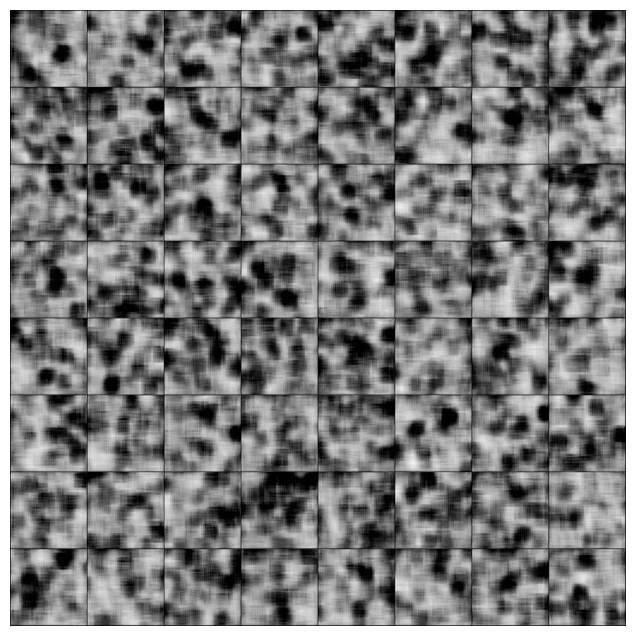

[53/70][0/1319]	Loss_D: 1.0496	Loss_G: 0.6492	D(x): 0.8111	D(G(z)): 0.5356 / 0.5318
[53/70][50/1319]	Loss_D: 0.9855	Loss_G: 0.7326	D(x): 0.7630	D(G(z)): 0.4816 / 0.4849
[53/70][100/1319]	Loss_D: 0.8992	Loss_G: 0.6817	D(x): 0.8768	D(G(z)): 0.5182 / 0.5129
[53/70][150/1319]	Loss_D: 0.9012	Loss_G: 0.7405	D(x): 0.8249	D(G(z)): 0.4788 / 0.4779
[53/70][200/1319]	Loss_D: 0.9927	Loss_G: 0.6306	D(x): 0.8720	D(G(z)): 0.5533 / 0.5401
[53/70][250/1319]	Loss_D: 1.0435	Loss_G: 0.6537	D(x): 0.7923	D(G(z)): 0.5247 / 0.5287
[53/70][300/1319]	Loss_D: 0.9995	Loss_G: 0.6773	D(x): 0.8289	D(G(z)): 0.5209 / 0.5190
[53/70][350/1319]	Loss_D: 0.9919	Loss_G: 0.6889	D(x): 0.8137	D(G(z)): 0.5167 / 0.5090
[53/70][400/1319]	Loss_D: 0.9633	Loss_G: 0.6612	D(x): 0.8530	D(G(z)): 0.5321 / 0.5266
[53/70][450/1319]	Loss_D: 0.8737	Loss_G: 0.7065	D(x): 0.8511	D(G(z)): 0.4922 / 0.4943
[53/70][500/1319]	Loss_D: 1.0198	Loss_G: 0.6392	D(x): 0.8338	D(G(z)): 0.5407 / 0.5368
[53/70][550/1319]	Loss_D: 0.9832	Loss_G: 0.6747	D(x): 0.8

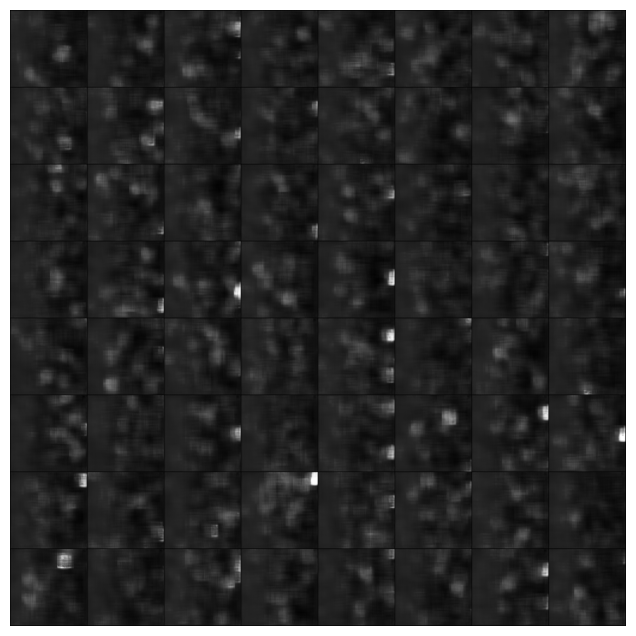

[56/70][50/1319]	Loss_D: 0.9910	Loss_G: 0.6219	D(x): 0.8503	D(G(z)): 0.5474 / 0.5424
[56/70][100/1319]	Loss_D: 1.0053	Loss_G: 0.7184	D(x): 0.7505	D(G(z)): 0.4797 / 0.4909


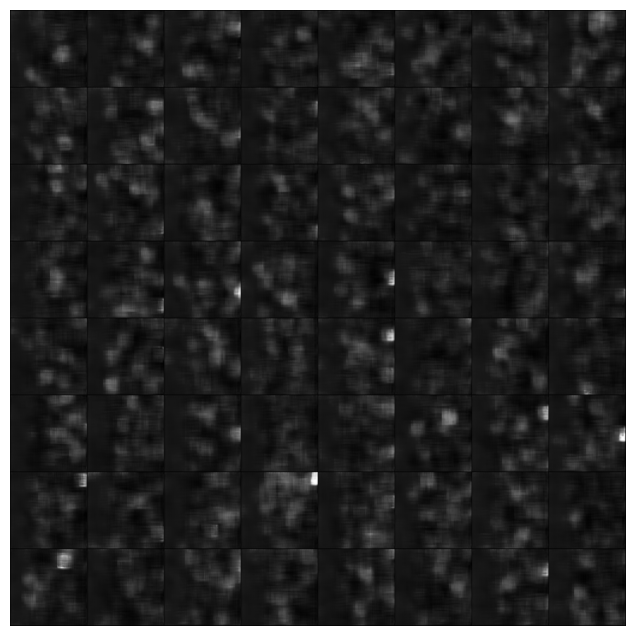

[56/70][150/1319]	Loss_D: 0.9673	Loss_G: 0.7663	D(x): 0.7836	D(G(z)): 0.4665 / 0.4664
[56/70][200/1319]	Loss_D: 0.9530	Loss_G: 0.7360	D(x): 0.7970	D(G(z)): 0.4869 / 0.4865


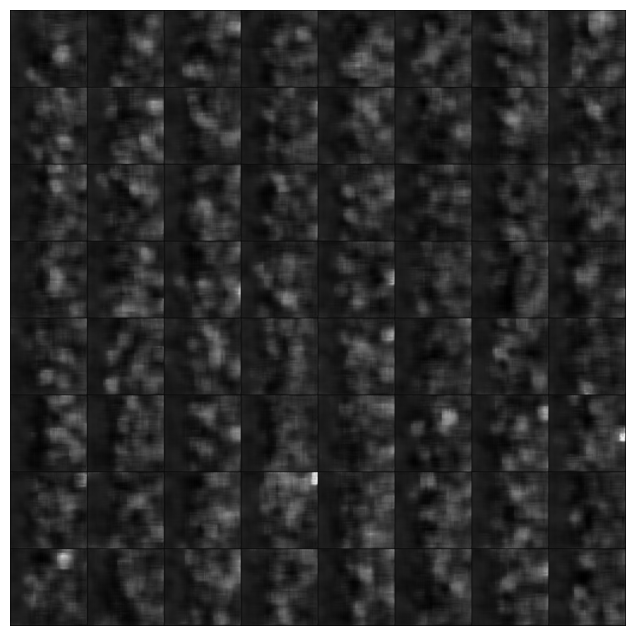

[56/70][250/1319]	Loss_D: 0.9668	Loss_G: 0.6567	D(x): 0.8406	D(G(z)): 0.5269 / 0.5232
[56/70][300/1319]	Loss_D: 1.0282	Loss_G: 0.6075	D(x): 0.8437	D(G(z)): 0.5535 / 0.5501


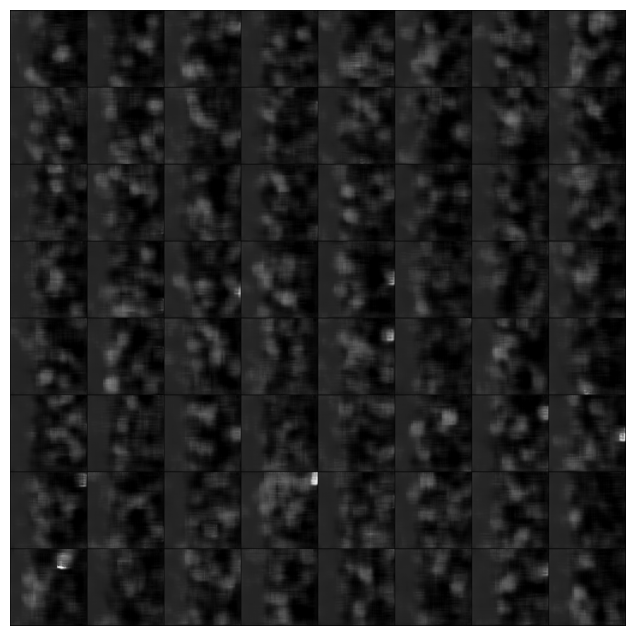

[56/70][350/1319]	Loss_D: 0.8880	Loss_G: 0.7094	D(x): 0.8677	D(G(z)): 0.5096 / 0.4982
[56/70][400/1319]	Loss_D: 0.9209	Loss_G: 0.8045	D(x): 0.8214	D(G(z)): 0.4631 / 0.4492


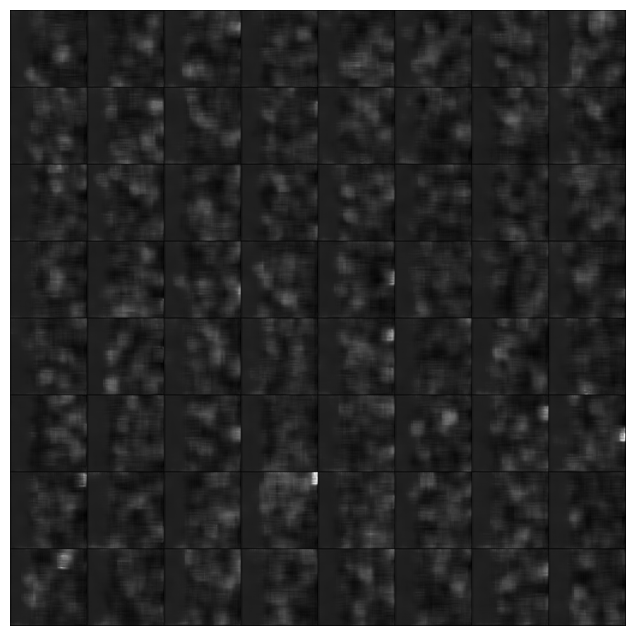

[56/70][450/1319]	Loss_D: 0.8334	Loss_G: 0.7884	D(x): 0.8395	D(G(z)): 0.4612 / 0.4549
[56/70][500/1319]	Loss_D: 0.8244	Loss_G: 0.7727	D(x): 0.8578	D(G(z)): 0.4706 / 0.4643


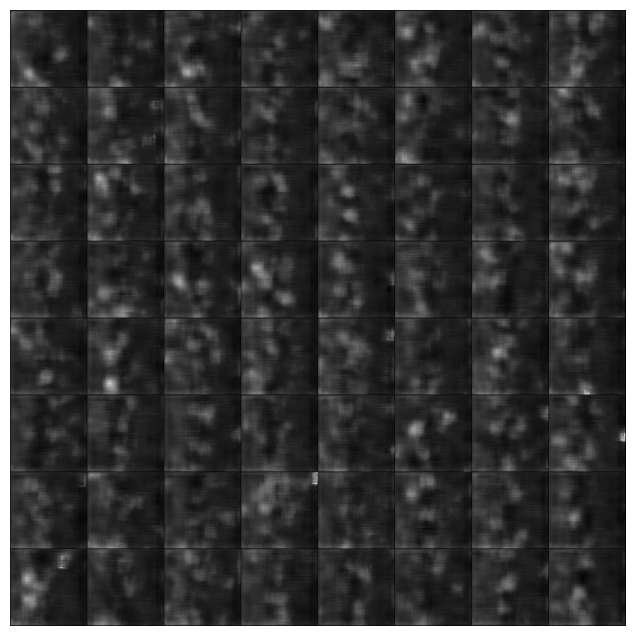

[56/70][550/1319]	Loss_D: 0.9953	Loss_G: 0.6225	D(x): 0.8580	D(G(z)): 0.5476 / 0.5451
[56/70][600/1319]	Loss_D: 0.9457	Loss_G: 0.6989	D(x): 0.8493	D(G(z)): 0.5118 / 0.5087


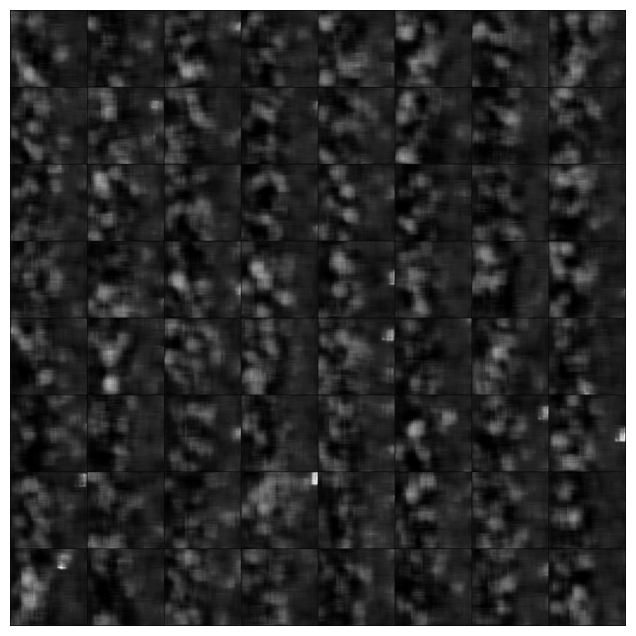

[56/70][650/1319]	Loss_D: 0.9545	Loss_G: 0.6790	D(x): 0.8412	D(G(z)): 0.5153 / 0.5167
[56/70][700/1319]	Loss_D: 0.9668	Loss_G: 0.6960	D(x): 0.8018	D(G(z)): 0.5049 / 0.5037


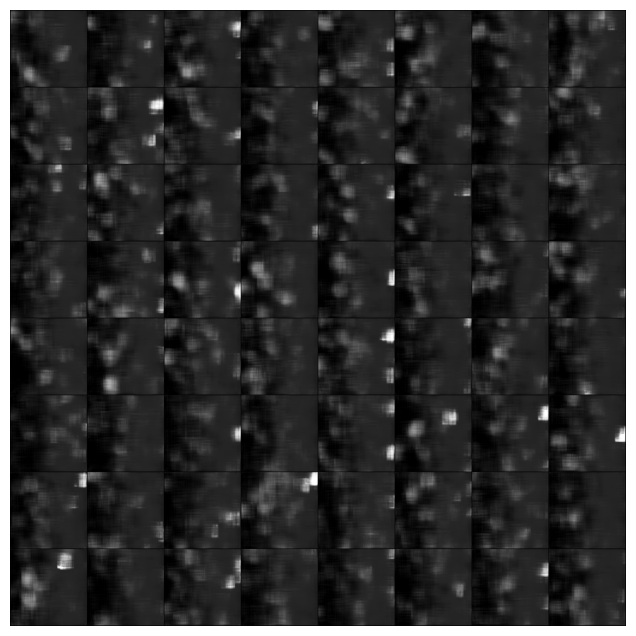

[56/70][750/1319]	Loss_D: 1.0373	Loss_G: 0.6171	D(x): 0.8122	D(G(z)): 0.5363 / 0.5457
[56/70][800/1319]	Loss_D: 0.9832	Loss_G: 0.6894	D(x): 0.8037	D(G(z)): 0.5052 / 0.5066


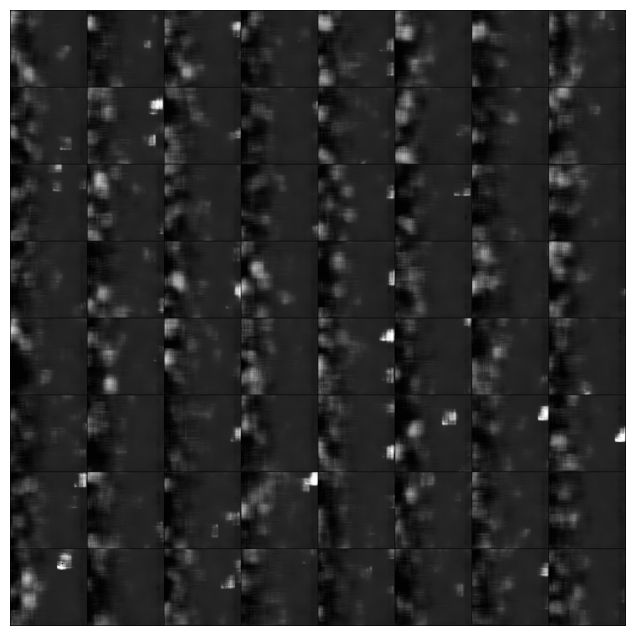

[56/70][850/1319]	Loss_D: 0.9775	Loss_G: 0.6814	D(x): 0.7894	D(G(z)): 0.5004 / 0.5128
[56/70][900/1319]	Loss_D: 0.9912	Loss_G: 0.6916	D(x): 0.8347	D(G(z)): 0.5250 / 0.5131


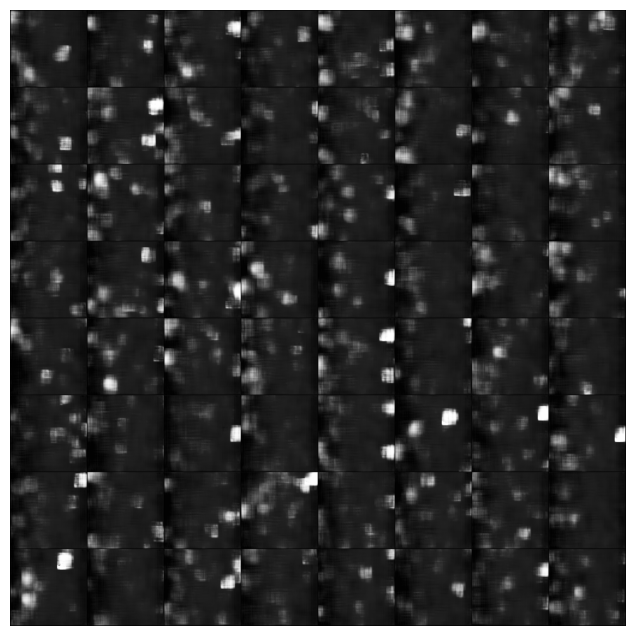

[56/70][950/1319]	Loss_D: 1.0138	Loss_G: 0.7264	D(x): 0.7504	D(G(z)): 0.4823 / 0.4872
[56/70][1000/1319]	Loss_D: 0.9163	Loss_G: 0.7387	D(x): 0.8275	D(G(z)): 0.4937 / 0.4819


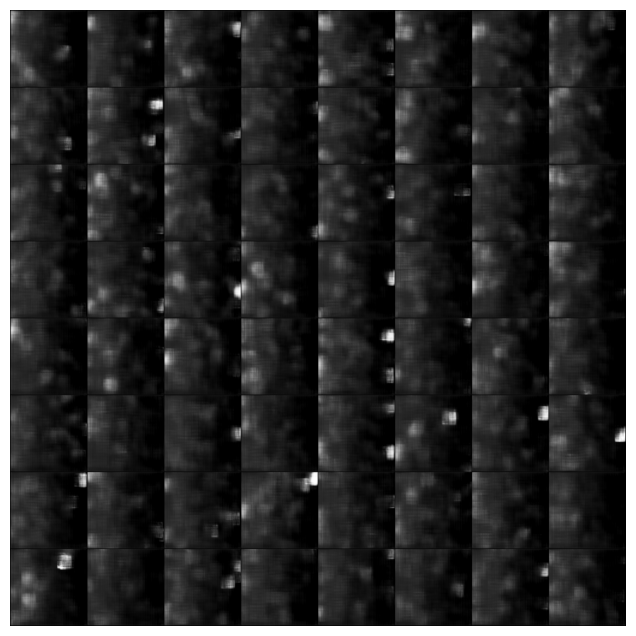

[56/70][1050/1319]	Loss_D: 0.9862	Loss_G: 0.6883	D(x): 0.8342	D(G(z)): 0.5253 / 0.5064
[56/70][1100/1319]	Loss_D: 0.9515	Loss_G: 0.7263	D(x): 0.7854	D(G(z)): 0.4765 / 0.4863


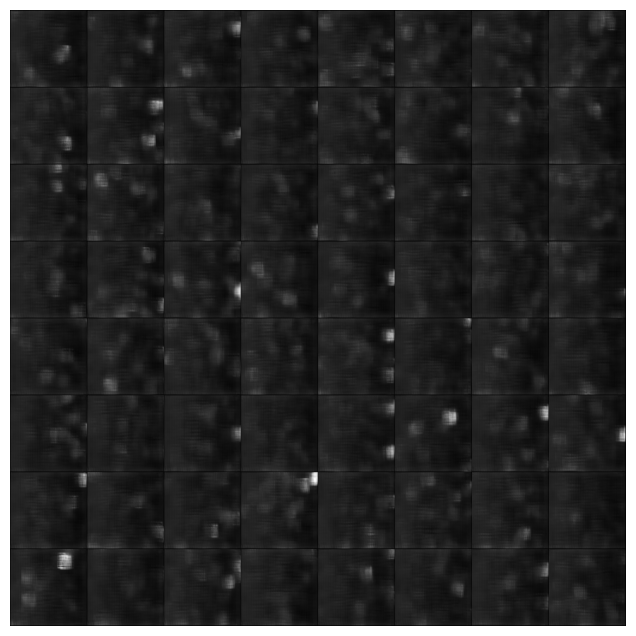

[56/70][1150/1319]	Loss_D: 0.9215	Loss_G: 0.6942	D(x): 0.8454	D(G(z)): 0.5100 / 0.5065
[56/70][1200/1319]	Loss_D: 1.1257	Loss_G: 0.6731	D(x): 0.7708	D(G(z)): 0.5292 / 0.5300


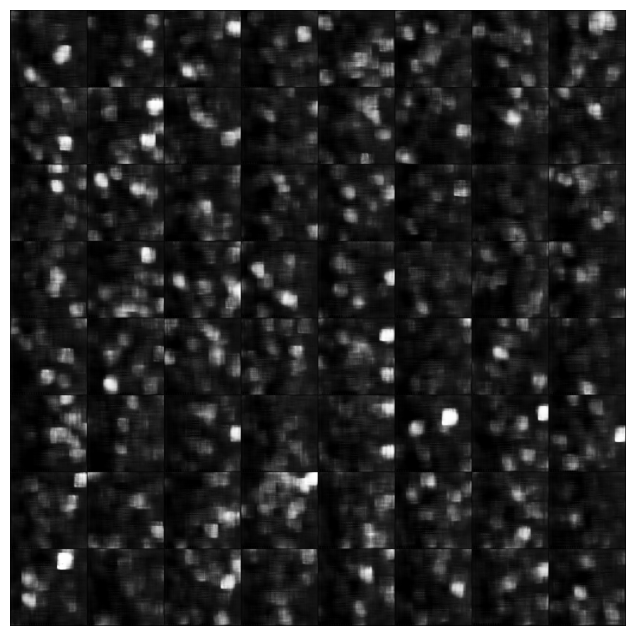

[56/70][1250/1319]	Loss_D: 1.0792	Loss_G: 0.6431	D(x): 0.7508	D(G(z)): 0.5198 / 0.5260
[56/70][1300/1319]	Loss_D: 1.0250	Loss_G: 0.6228	D(x): 0.8135	D(G(z)): 0.5397 / 0.5399


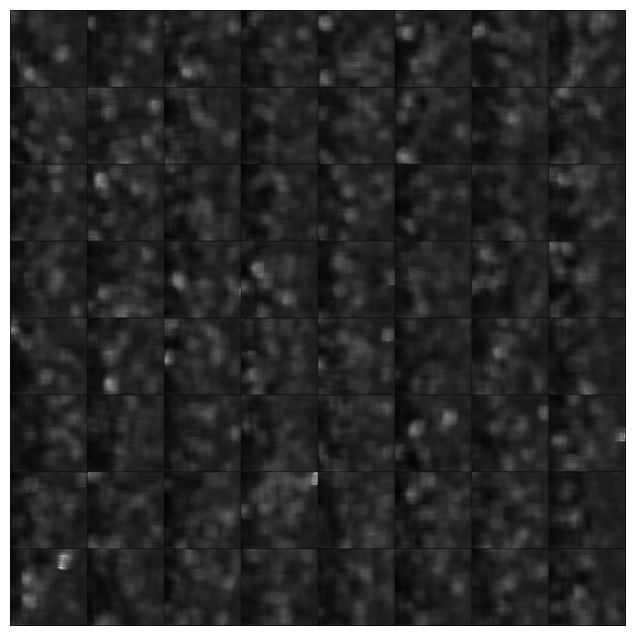

[57/70][0/1319]	Loss_D: 1.0226	Loss_G: 0.6301	D(x): 0.8411	D(G(z)): 0.5406 / 0.5424
[57/70][50/1319]	Loss_D: 1.0291	Loss_G: 0.6441	D(x): 0.8409	D(G(z)): 0.5420 / 0.5372
[57/70][100/1319]	Loss_D: 0.9632	Loss_G: 0.6668	D(x): 0.8371	D(G(z)): 0.5273 / 0.5181
[57/70][150/1319]	Loss_D: 1.0843	Loss_G: 0.6532	D(x): 0.7581	D(G(z)): 0.5018 / 0.5234
[57/70][200/1319]	Loss_D: 0.9182	Loss_G: 0.6950	D(x): 0.8434	D(G(z)): 0.5110 / 0.5025
[57/70][250/1319]	Loss_D: 1.0995	Loss_G: 0.5952	D(x): 0.8538	D(G(z)): 0.5678 / 0.5689
[57/70][300/1319]	Loss_D: 1.0511	Loss_G: 0.6486	D(x): 0.7930	D(G(z)): 0.5338 / 0.5305
[57/70][350/1319]	Loss_D: 1.0949	Loss_G: 0.6517	D(x): 0.7364	D(G(z)): 0.5147 / 0.5228
[57/70][400/1319]	Loss_D: 1.0789	Loss_G: 0.6042	D(x): 0.8178	D(G(z)): 0.5501 / 0.5517
[57/70][450/1319]	Loss_D: 1.0942	Loss_G: 0.6591	D(x): 0.7900	D(G(z)): 0.5290 / 0.5307
[57/70][500/1319]	Loss_D: 1.0070	Loss_G: 0.6877	D(x): 0.8007	D(G(z)): 0.5156 / 0.5126
[57/70][550/1319]	Loss_D: 0.9385	Loss_G: 0.6932	D(x): 0.8

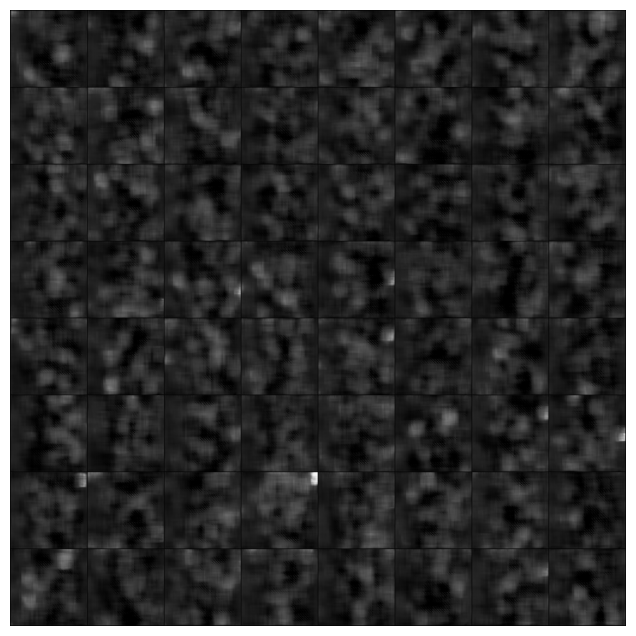

[60/70][50/1319]	Loss_D: 0.8579	Loss_G: 0.7254	D(x): 0.8643	D(G(z)): 0.4907 / 0.4907
[60/70][100/1319]	Loss_D: 0.8736	Loss_G: 0.7224	D(x): 0.8608	D(G(z)): 0.4955 / 0.4896


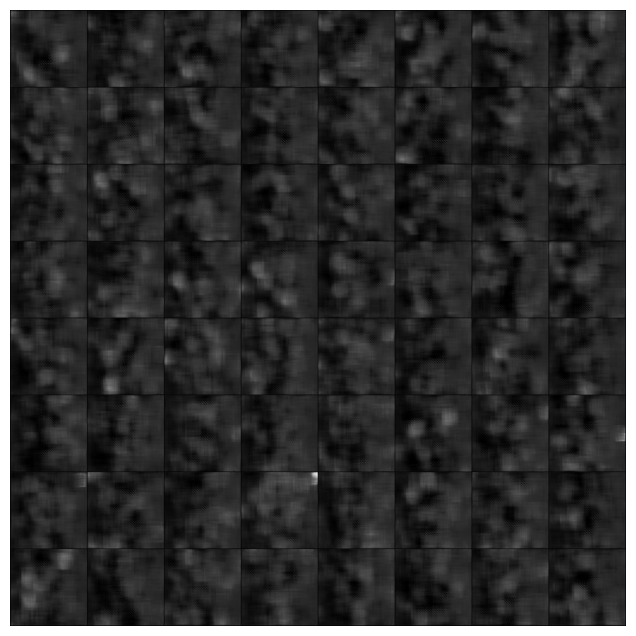

[60/70][150/1319]	Loss_D: 1.0171	Loss_G: 0.6461	D(x): 0.8341	D(G(z)): 0.5405 / 0.5317
[60/70][200/1319]	Loss_D: 1.0650	Loss_G: 0.5991	D(x): 0.8295	D(G(z)): 0.5621 / 0.5547


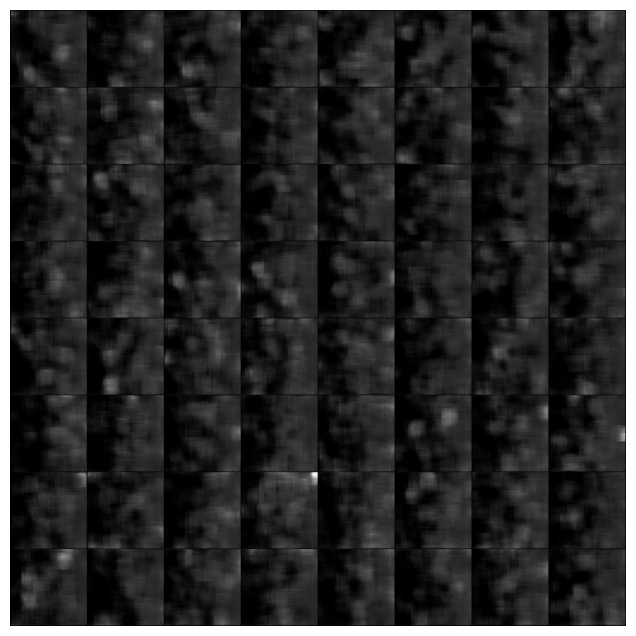

[60/70][250/1319]	Loss_D: 0.9780	Loss_G: 0.6304	D(x): 0.8503	D(G(z)): 0.5402 / 0.5364
[60/70][300/1319]	Loss_D: 0.9267	Loss_G: 0.6705	D(x): 0.8593	D(G(z)): 0.5194 / 0.5167


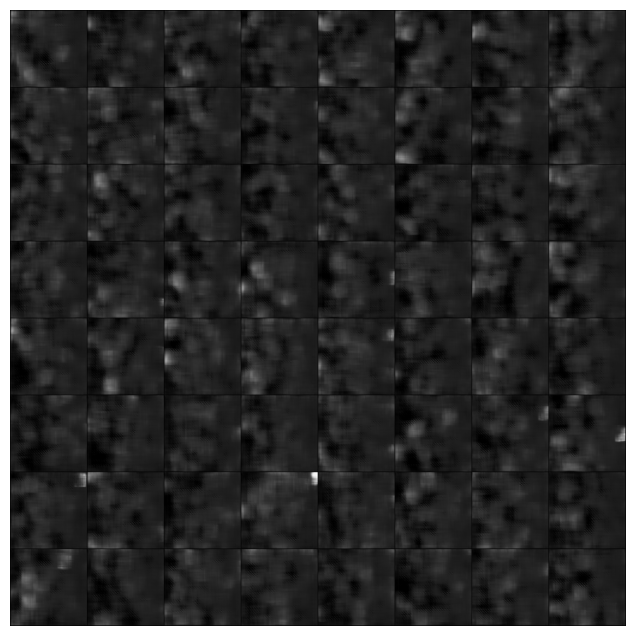

[60/70][350/1319]	Loss_D: 1.0548	Loss_G: 0.6535	D(x): 0.7840	D(G(z)): 0.5216 / 0.5263
[60/70][400/1319]	Loss_D: 1.1921	Loss_G: 0.5586	D(x): 0.8079	D(G(z)): 0.5882 / 0.5784


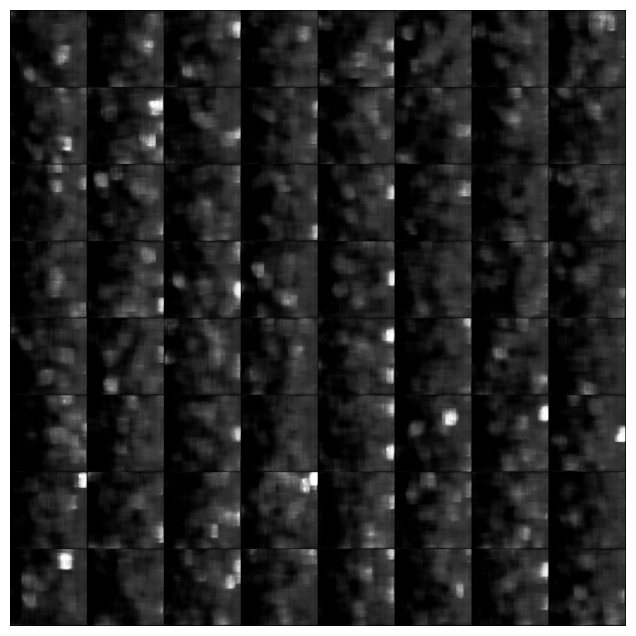

[60/70][450/1319]	Loss_D: 0.9905	Loss_G: 0.6727	D(x): 0.8270	D(G(z)): 0.5245 / 0.5125
[60/70][500/1319]	Loss_D: 0.9453	Loss_G: 0.6715	D(x): 0.8692	D(G(z)): 0.5280 / 0.5187


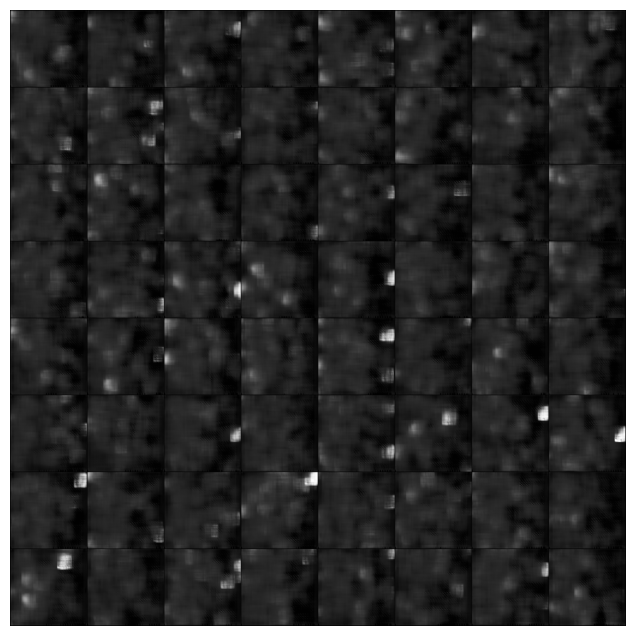

[60/70][550/1319]	Loss_D: 0.9683	Loss_G: 0.6365	D(x): 0.8640	D(G(z)): 0.5404 / 0.5373
[60/70][600/1319]	Loss_D: 1.0345	Loss_G: 0.6547	D(x): 0.8454	D(G(z)): 0.5425 / 0.5346


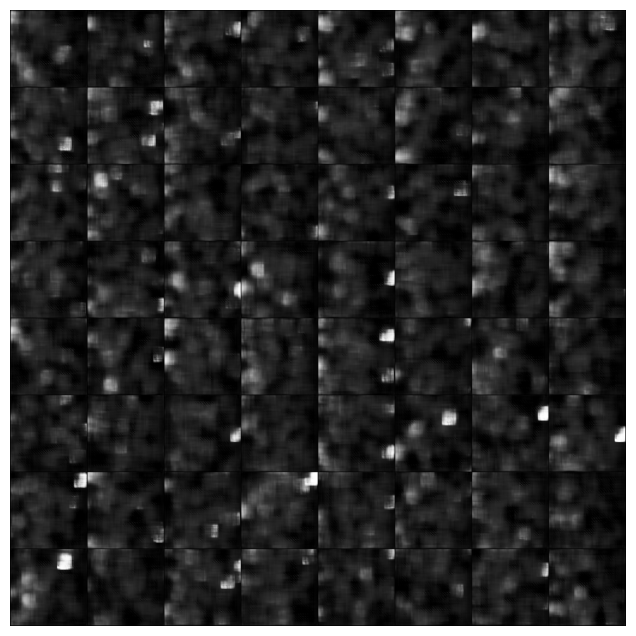

[60/70][650/1319]	Loss_D: 1.0392	Loss_G: 0.6798	D(x): 0.7856	D(G(z)): 0.5078 / 0.5086
[60/70][700/1319]	Loss_D: 0.9758	Loss_G: 0.6908	D(x): 0.8203	D(G(z)): 0.5125 / 0.5080


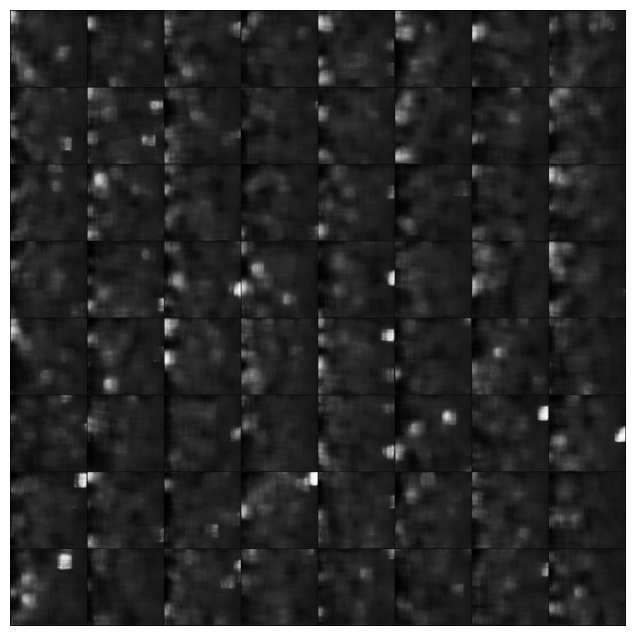

[60/70][750/1319]	Loss_D: 1.0875	Loss_G: 0.6917	D(x): 0.8340	D(G(z)): 0.5433 / 0.5343
[60/70][800/1319]	Loss_D: 0.8796	Loss_G: 0.7048	D(x): 0.8880	D(G(z)): 0.5084 / 0.5060


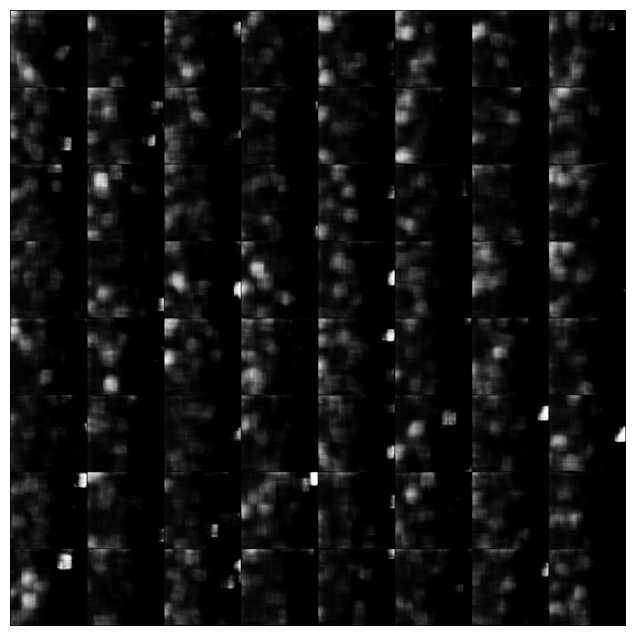

[60/70][850/1319]	Loss_D: 0.9678	Loss_G: 0.7182	D(x): 0.8032	D(G(z)): 0.5063 / 0.4879
[60/70][900/1319]	Loss_D: 0.9387	Loss_G: 0.6786	D(x): 0.8482	D(G(z)): 0.5188 / 0.5100


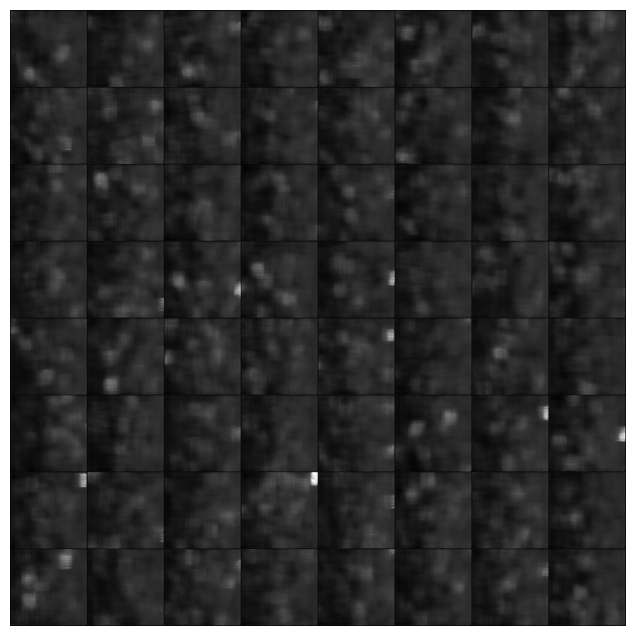

[60/70][950/1319]	Loss_D: 0.9875	Loss_G: 0.6456	D(x): 0.8277	D(G(z)): 0.5264 / 0.5332
[60/70][1000/1319]	Loss_D: 1.0091	Loss_G: 0.6598	D(x): 0.8200	D(G(z)): 0.5311 / 0.5223


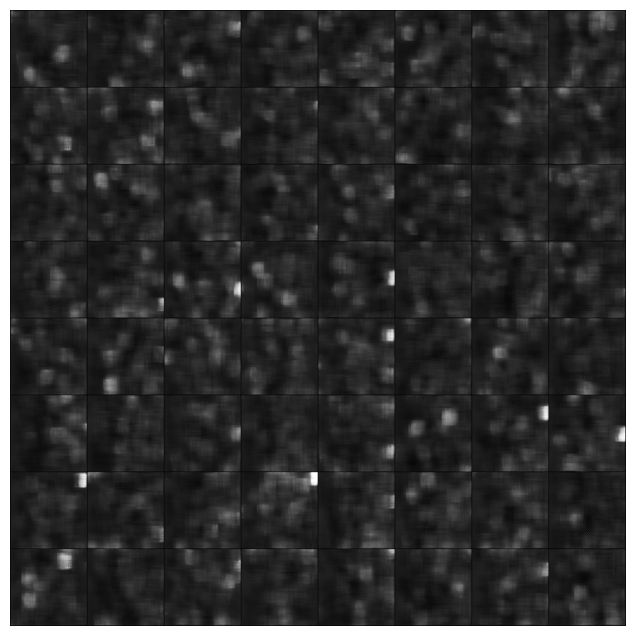

[60/70][1050/1319]	Loss_D: 0.8542	Loss_G: 0.7192	D(x): 0.8812	D(G(z)): 0.5025 / 0.4924
[60/70][1100/1319]	Loss_D: 0.9679	Loss_G: 0.6293	D(x): 0.8770	D(G(z)): 0.5532 / 0.5378


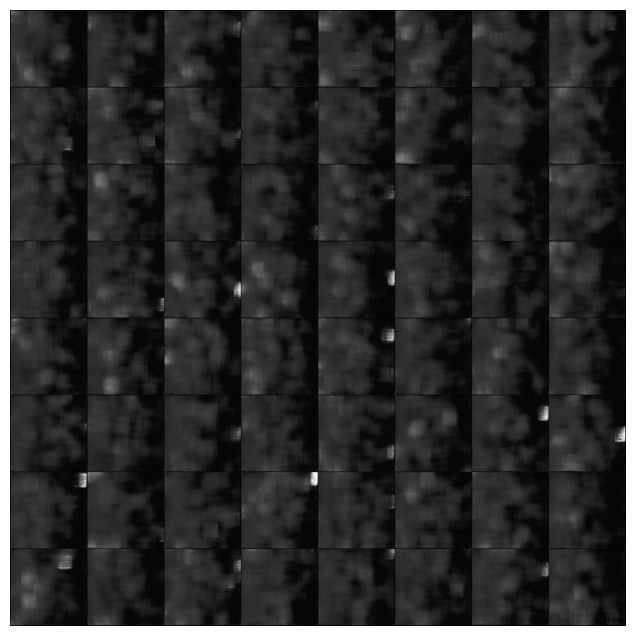

[60/70][1150/1319]	Loss_D: 1.0747	Loss_G: 0.6607	D(x): 0.7659	D(G(z)): 0.5156 / 0.5187
[60/70][1200/1319]	Loss_D: 0.9389	Loss_G: 0.7188	D(x): 0.8283	D(G(z)): 0.4966 / 0.4898


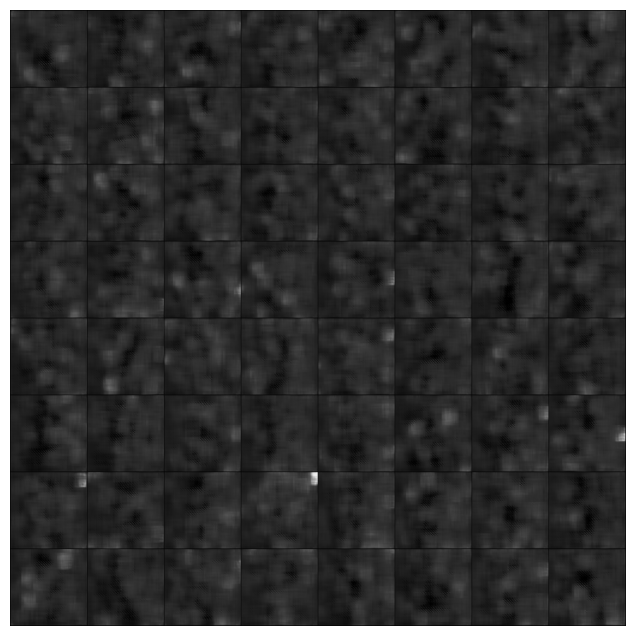

[60/70][1250/1319]	Loss_D: 0.9651	Loss_G: 0.6418	D(x): 0.8502	D(G(z)): 0.5345 / 0.5323
[60/70][1300/1319]	Loss_D: 1.0442	Loss_G: 0.6653	D(x): 0.7991	D(G(z)): 0.5236 / 0.5247


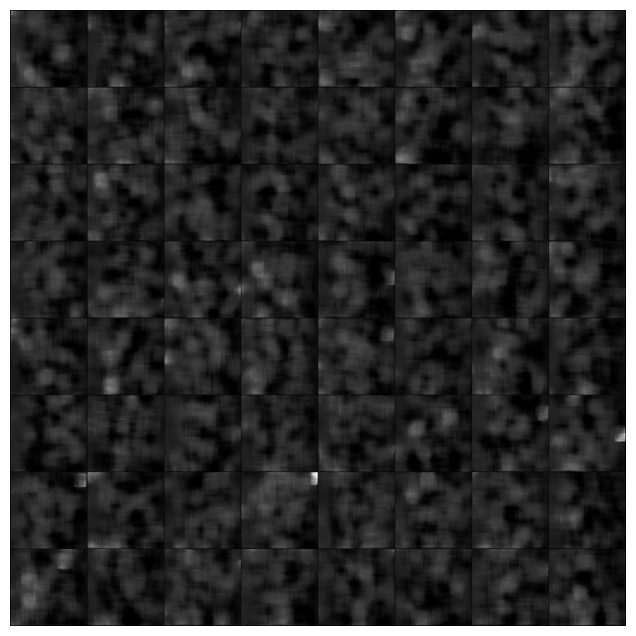

[61/70][0/1319]	Loss_D: 0.9983	Loss_G: 0.6825	D(x): 0.8171	D(G(z)): 0.5216 / 0.5157
[61/70][50/1319]	Loss_D: 1.0895	Loss_G: 0.6696	D(x): 0.7603	D(G(z)): 0.5213 / 0.5198
[61/70][100/1319]	Loss_D: 0.9623	Loss_G: 0.6484	D(x): 0.8495	D(G(z)): 0.5310 / 0.5286
[61/70][150/1319]	Loss_D: 0.8646	Loss_G: 0.7053	D(x): 0.8874	D(G(z)): 0.5099 / 0.5011
[61/70][200/1319]	Loss_D: 0.8780	Loss_G: 0.7391	D(x): 0.8400	D(G(z)): 0.4875 / 0.4826
[61/70][250/1319]	Loss_D: 1.0257	Loss_G: 0.6879	D(x): 0.7647	D(G(z)): 0.4964 / 0.5050
[61/70][300/1319]	Loss_D: 1.0193	Loss_G: 0.6895	D(x): 0.7849	D(G(z)): 0.5042 / 0.5078
[61/70][350/1319]	Loss_D: 0.9556	Loss_G: 0.6847	D(x): 0.8185	D(G(z)): 0.5072 / 0.5111
[61/70][400/1319]	Loss_D: 0.9802	Loss_G: 0.6747	D(x): 0.8321	D(G(z)): 0.5153 / 0.5149
[61/70][450/1319]	Loss_D: 0.9493	Loss_G: 0.7032	D(x): 0.8181	D(G(z)): 0.5041 / 0.5017
[61/70][500/1319]	Loss_D: 0.9542	Loss_G: 0.7014	D(x): 0.8182	D(G(z)): 0.5096 / 0.4985
[61/70][550/1319]	Loss_D: 0.9122	Loss_G: 0.6840	D(x): 0.8

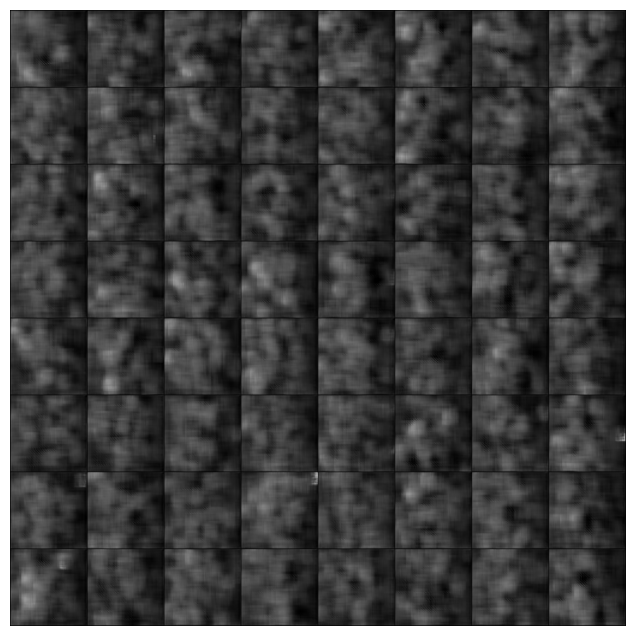

[64/70][50/1319]	Loss_D: 1.0510	Loss_G: 0.5865	D(x): 0.8587	D(G(z)): 0.5718 / 0.5625
[64/70][100/1319]	Loss_D: 0.9408	Loss_G: 0.7353	D(x): 0.8123	D(G(z)): 0.4866 / 0.4849


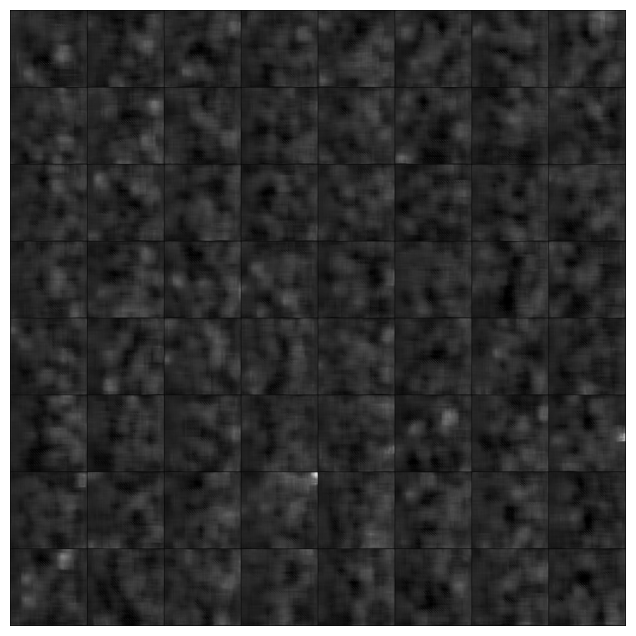

[64/70][150/1319]	Loss_D: 0.9482	Loss_G: 0.6345	D(x): 0.8896	D(G(z)): 0.5471 / 0.5361
[64/70][200/1319]	Loss_D: 0.8878	Loss_G: 0.6994	D(x): 0.8594	D(G(z)): 0.5047 / 0.4994


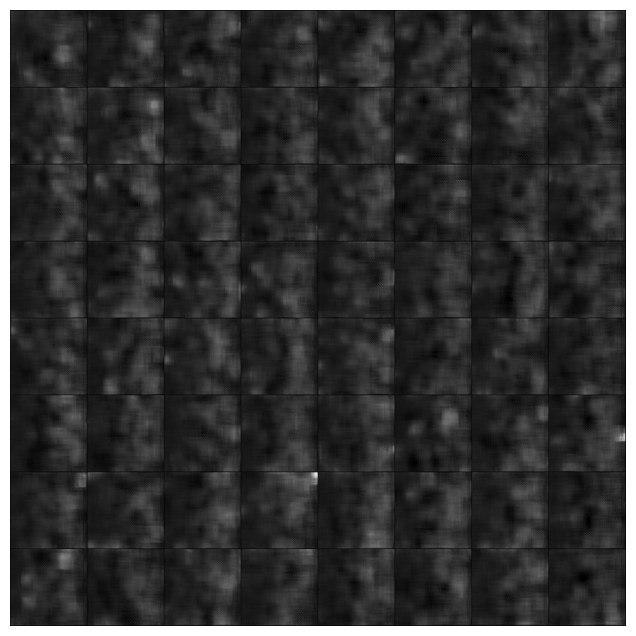

[64/70][250/1319]	Loss_D: 1.0334	Loss_G: 0.7006	D(x): 0.7804	D(G(z)): 0.4940 / 0.5040
[64/70][300/1319]	Loss_D: 0.9151	Loss_G: 0.6890	D(x): 0.8875	D(G(z)): 0.5241 / 0.5123


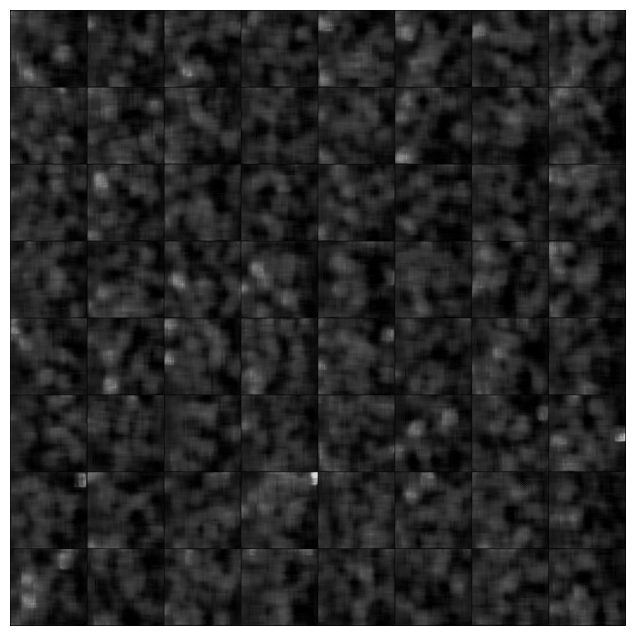

[64/70][350/1319]	Loss_D: 0.9489	Loss_G: 0.6978	D(x): 0.8319	D(G(z)): 0.5124 / 0.5049
[64/70][400/1319]	Loss_D: 0.9229	Loss_G: 0.7078	D(x): 0.8273	D(G(z)): 0.5010 / 0.4953


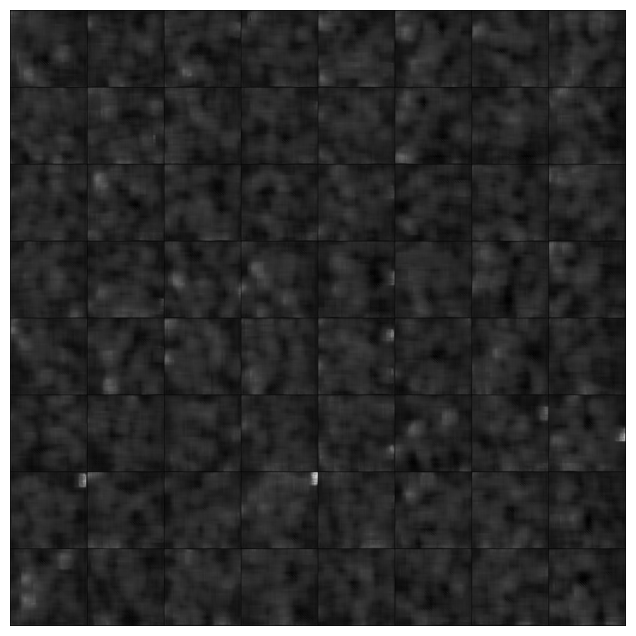

[64/70][450/1319]	Loss_D: 0.9465	Loss_G: 0.6494	D(x): 0.8897	D(G(z)): 0.5431 / 0.5331
[64/70][500/1319]	Loss_D: 0.8923	Loss_G: 0.7426	D(x): 0.8394	D(G(z)): 0.4871 / 0.4820


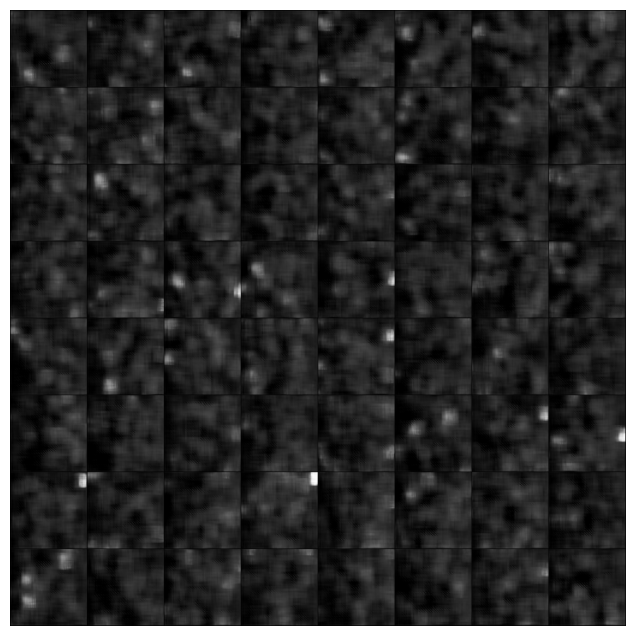

[64/70][550/1319]	Loss_D: 0.9448	Loss_G: 0.6976	D(x): 0.8353	D(G(z)): 0.5084 / 0.5042
[64/70][600/1319]	Loss_D: 1.0283	Loss_G: 0.6765	D(x): 0.7954	D(G(z)): 0.5199 / 0.5160


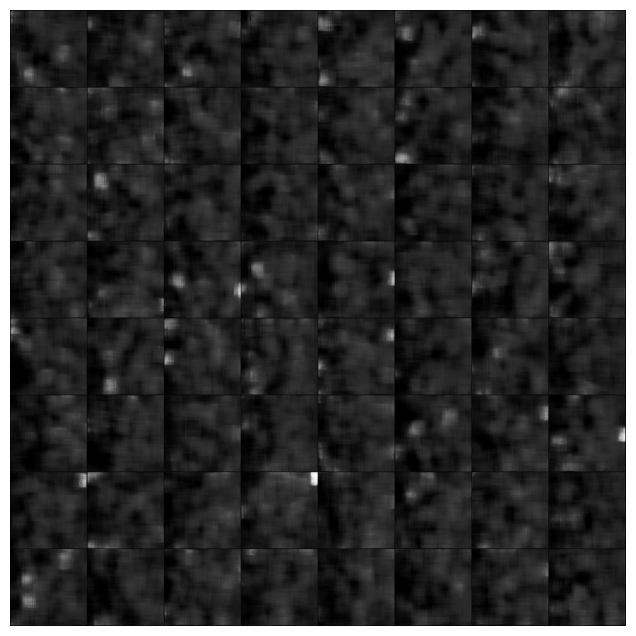

[64/70][650/1319]	Loss_D: 0.9720	Loss_G: 0.6426	D(x): 0.8430	D(G(z)): 0.5335 / 0.5283
[64/70][700/1319]	Loss_D: 0.8911	Loss_G: 0.7322	D(x): 0.8521	D(G(z)): 0.4944 / 0.4853


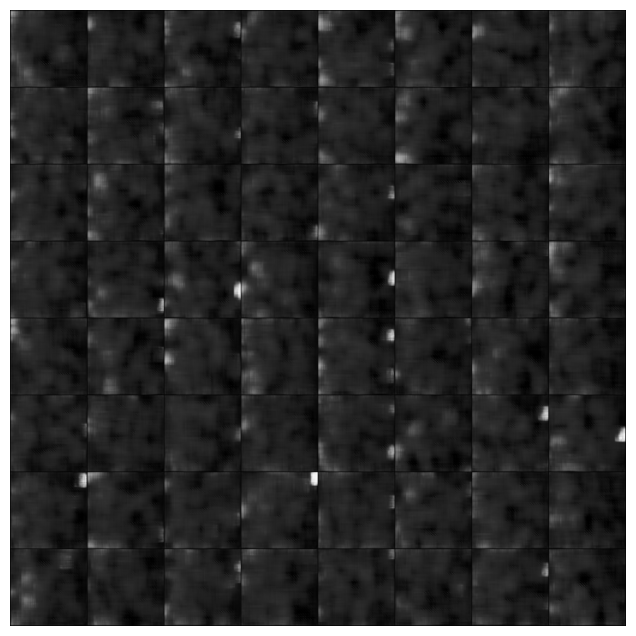

[64/70][750/1319]	Loss_D: 0.9615	Loss_G: 0.6796	D(x): 0.8720	D(G(z)): 0.5314 / 0.5186
[64/70][800/1319]	Loss_D: 1.0549	Loss_G: 0.7003	D(x): 0.7569	D(G(z)): 0.4929 / 0.5042


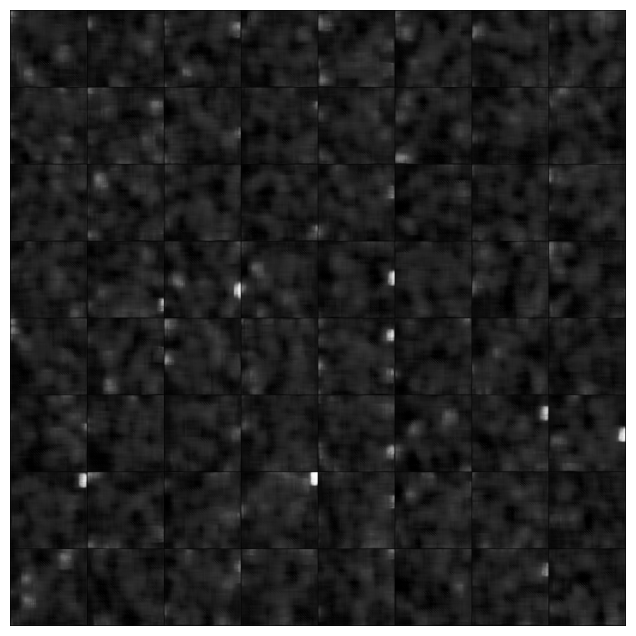

[64/70][850/1319]	Loss_D: 0.9688	Loss_G: 0.7282	D(x): 0.8251	D(G(z)): 0.5031 / 0.4996
[64/70][900/1319]	Loss_D: 0.9359	Loss_G: 0.6894	D(x): 0.8352	D(G(z)): 0.5118 / 0.5063


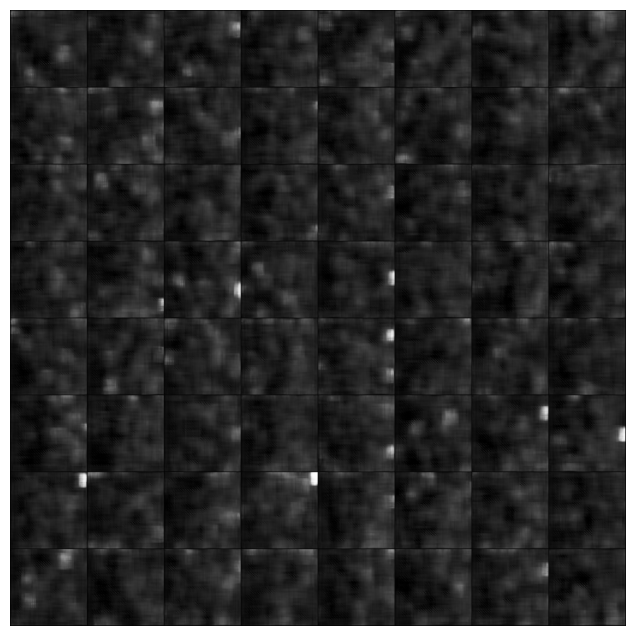

[64/70][950/1319]	Loss_D: 0.9243	Loss_G: 0.6800	D(x): 0.8628	D(G(z)): 0.5235 / 0.5096
[64/70][1000/1319]	Loss_D: 0.9751	Loss_G: 0.6655	D(x): 0.8466	D(G(z)): 0.5273 / 0.5206


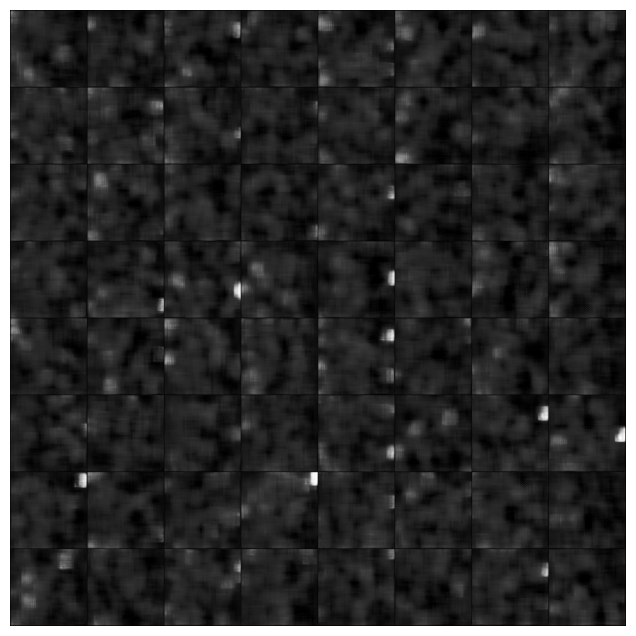

[64/70][1050/1319]	Loss_D: 0.9202	Loss_G: 0.6692	D(x): 0.8716	D(G(z)): 0.5255 / 0.5181
[64/70][1100/1319]	Loss_D: 0.9559	Loss_G: 0.6464	D(x): 0.8883	D(G(z)): 0.5434 / 0.5325


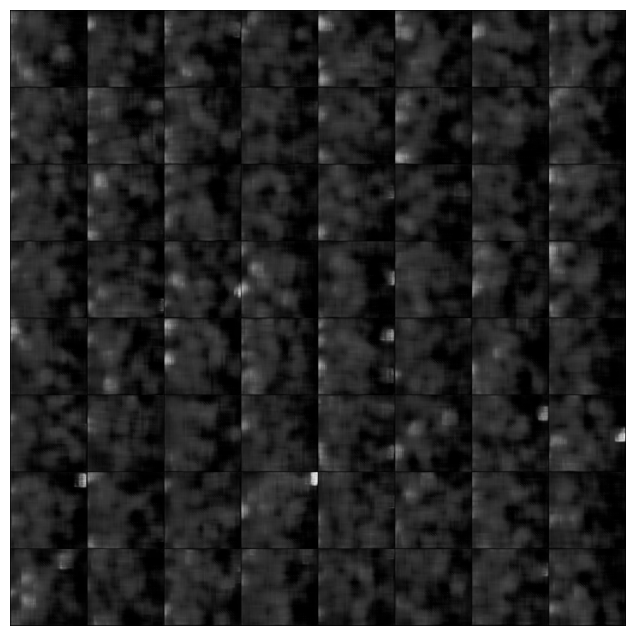

[64/70][1150/1319]	Loss_D: 0.9019	Loss_G: 0.6887	D(x): 0.8663	D(G(z)): 0.5164 / 0.5040
[64/70][1200/1319]	Loss_D: 0.9822	Loss_G: 0.6692	D(x): 0.8152	D(G(z)): 0.5165 / 0.5171


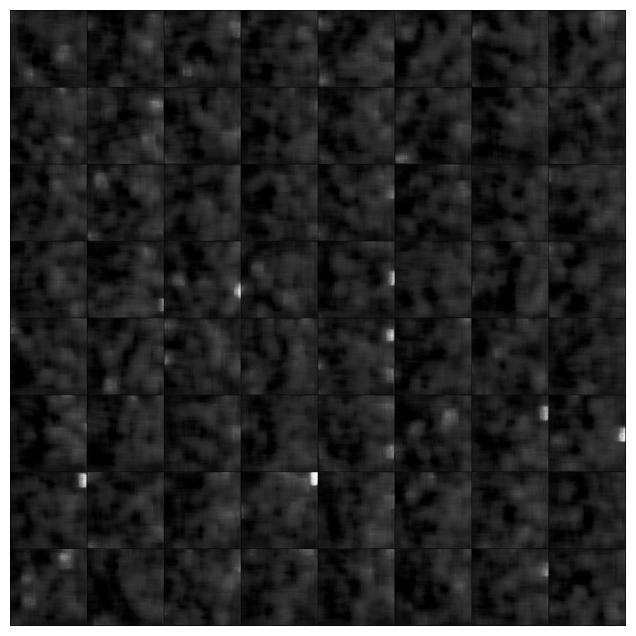

[64/70][1250/1319]	Loss_D: 0.9414	Loss_G: 0.7441	D(x): 0.8052	D(G(z)): 0.4827 / 0.4833
[64/70][1300/1319]	Loss_D: 0.8859	Loss_G: 0.7293	D(x): 0.8592	D(G(z)): 0.4984 / 0.4874


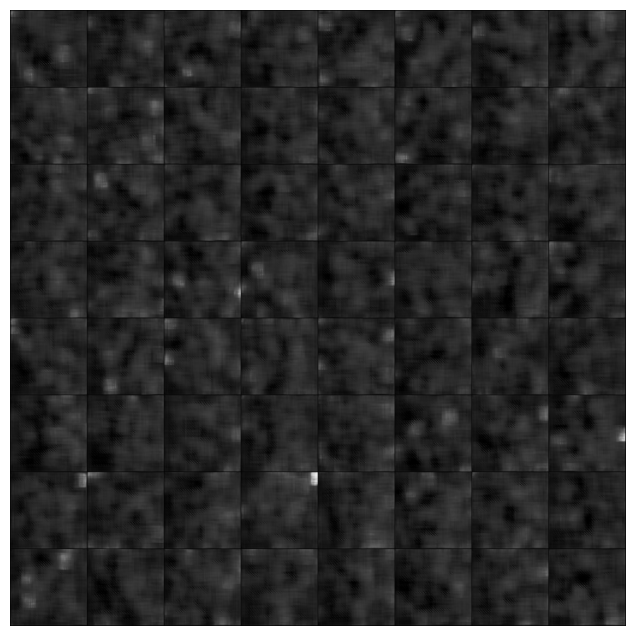

[65/70][0/1319]	Loss_D: 0.9595	Loss_G: 0.6874	D(x): 0.8485	D(G(z)): 0.5230 / 0.5120
[65/70][50/1319]	Loss_D: 0.8805	Loss_G: 0.7343	D(x): 0.8728	D(G(z)): 0.5049 / 0.4890
[65/70][100/1319]	Loss_D: 0.9494	Loss_G: 0.6909	D(x): 0.8239	D(G(z)): 0.5080 / 0.5035
[65/70][150/1319]	Loss_D: 0.9721	Loss_G: 0.6286	D(x): 0.8570	D(G(z)): 0.5384 / 0.5383
[65/70][200/1319]	Loss_D: 1.0598	Loss_G: 0.6842	D(x): 0.7821	D(G(z)): 0.5144 / 0.5173
[65/70][250/1319]	Loss_D: 0.9286	Loss_G: 0.6810	D(x): 0.8265	D(G(z)): 0.5037 / 0.5083
[65/70][300/1319]	Loss_D: 1.0491	Loss_G: 0.6104	D(x): 0.8354	D(G(z)): 0.5510 / 0.5528
[65/70][350/1319]	Loss_D: 0.9580	Loss_G: 0.6269	D(x): 0.8772	D(G(z)): 0.5411 / 0.5428
[65/70][400/1319]	Loss_D: 0.9893	Loss_G: 0.7651	D(x): 0.7907	D(G(z)): 0.4935 / 0.4691
[65/70][450/1319]	Loss_D: 0.9696	Loss_G: 0.6869	D(x): 0.8298	D(G(z)): 0.5118 / 0.5042
[65/70][500/1319]	Loss_D: 0.8567	Loss_G: 0.9764	D(x): 0.7857	D(G(z)): 0.4200 / 0.3780
[65/70][550/1319]	Loss_D: 0.7619	Loss_G: 0.9280	D(x): 0.8

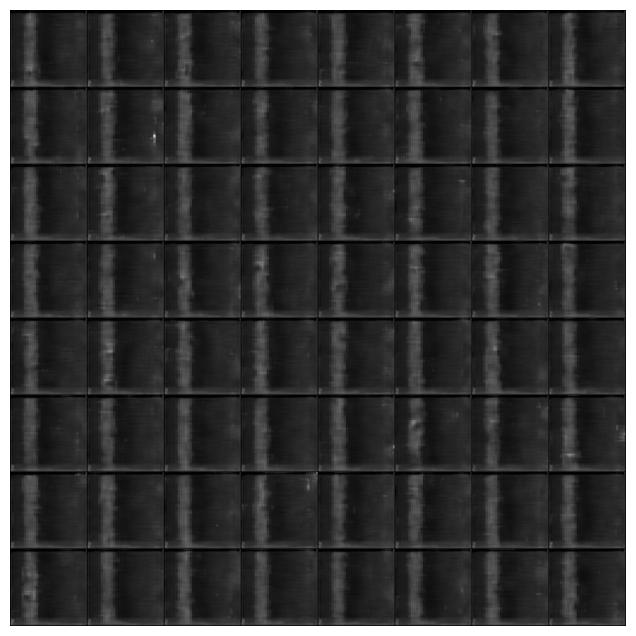

[68/70][50/1319]	Loss_D: 0.7954	Loss_G: 0.7713	D(x): 0.8704	D(G(z)): 0.4710 / 0.4627
[68/70][100/1319]	Loss_D: 0.9473	Loss_G: 0.6696	D(x): 0.8347	D(G(z)): 0.5053 / 0.5133


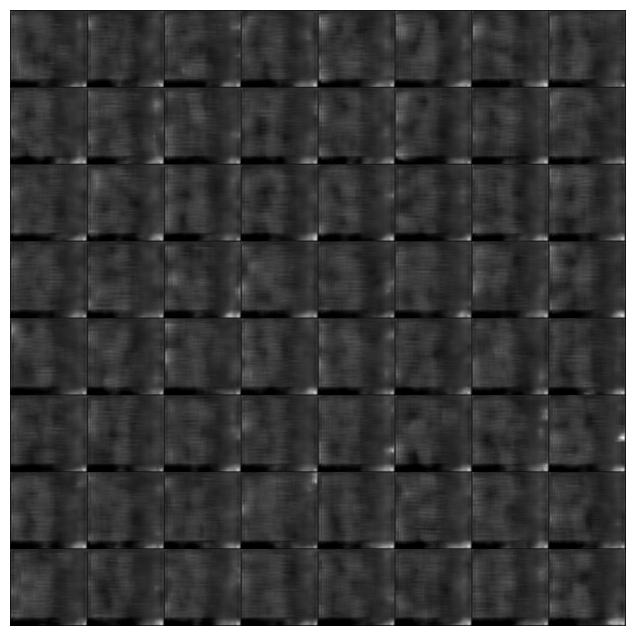

[68/70][150/1319]	Loss_D: 0.8438	Loss_G: 0.7118	D(x): 0.9109	D(G(z)): 0.5092 / 0.4998
[68/70][200/1319]	Loss_D: 1.0713	Loss_G: 0.6542	D(x): 0.8275	D(G(z)): 0.5378 / 0.5364


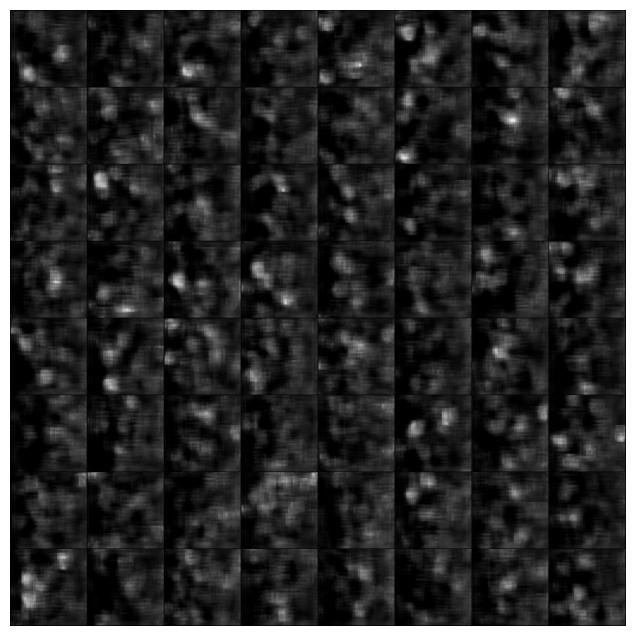

[68/70][250/1319]	Loss_D: 1.0203	Loss_G: 0.6205	D(x): 0.8853	D(G(z)): 0.5585 / 0.5548
[68/70][300/1319]	Loss_D: 1.0674	Loss_G: 0.5817	D(x): 0.8856	D(G(z)): 0.5796 / 0.5710


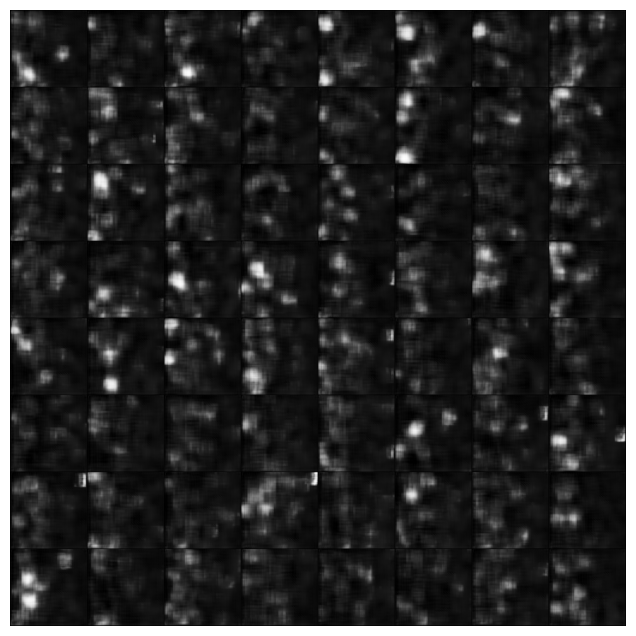

[68/70][350/1319]	Loss_D: 0.9800	Loss_G: 0.7355	D(x): 0.7595	D(G(z)): 0.4770 / 0.4801
[68/70][400/1319]	Loss_D: 1.0519	Loss_G: 0.6849	D(x): 0.7515	D(G(z)): 0.4882 / 0.5052


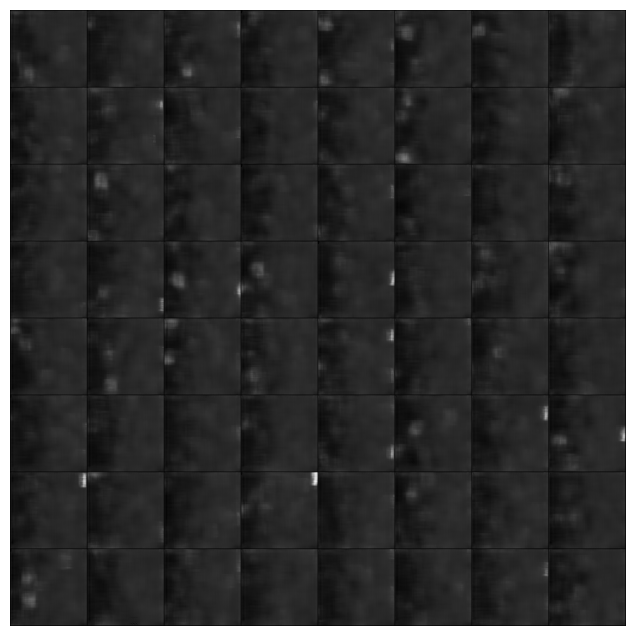

[68/70][450/1319]	Loss_D: 0.9290	Loss_G: 0.6490	D(x): 0.8625	D(G(z)): 0.5274 / 0.5280
[68/70][500/1319]	Loss_D: 0.9563	Loss_G: 0.7090	D(x): 0.8324	D(G(z)): 0.5063 / 0.5052


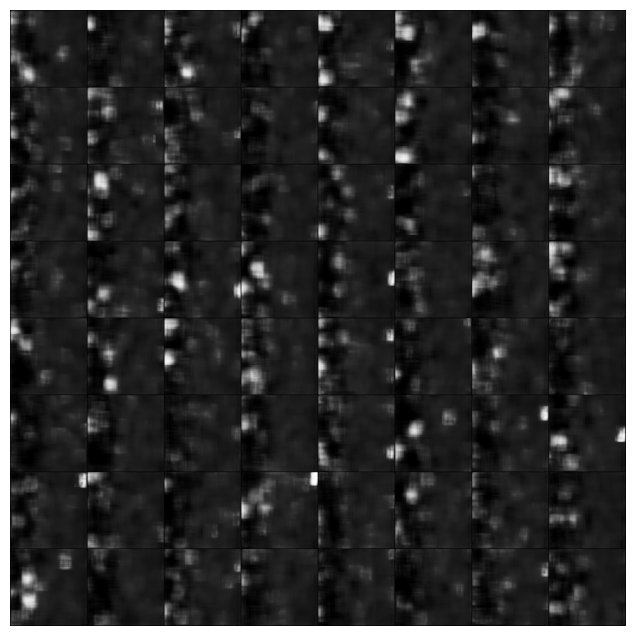

[68/70][550/1319]	Loss_D: 1.0372	Loss_G: 0.6423	D(x): 0.8448	D(G(z)): 0.5456 / 0.5423
[68/70][600/1319]	Loss_D: 1.0508	Loss_G: 0.6707	D(x): 0.8477	D(G(z)): 0.5323 / 0.5327


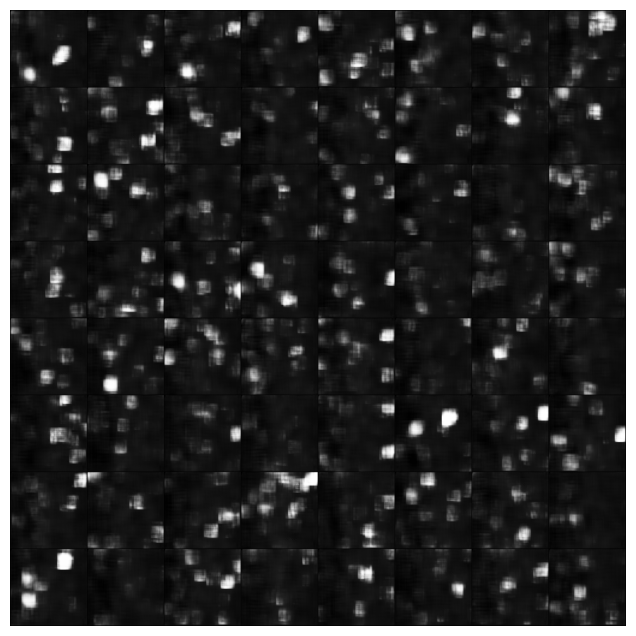

[68/70][650/1319]	Loss_D: 0.9925	Loss_G: 0.6742	D(x): 0.8405	D(G(z)): 0.5259 / 0.5204
[68/70][700/1319]	Loss_D: 0.9054	Loss_G: 0.7112	D(x): 0.8276	D(G(z)): 0.4936 / 0.4919


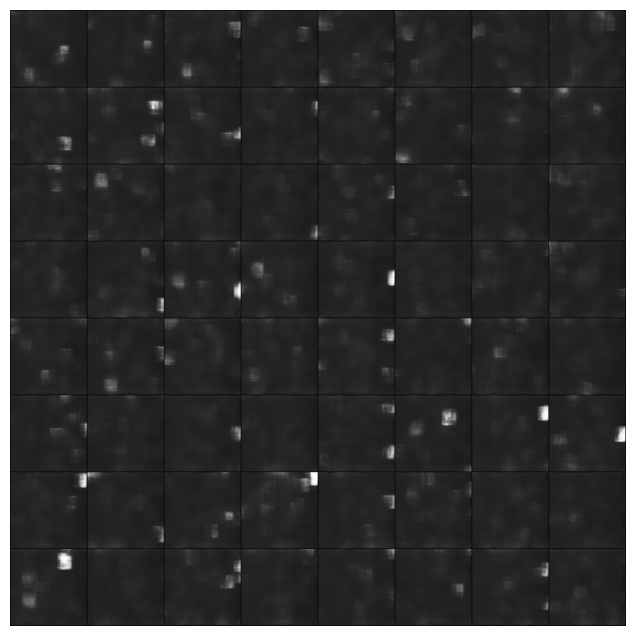

[68/70][750/1319]	Loss_D: 1.0530	Loss_G: 0.6382	D(x): 0.8037	D(G(z)): 0.5345 / 0.5327
[68/70][800/1319]	Loss_D: 1.0103	Loss_G: 0.6450	D(x): 0.8571	D(G(z)): 0.5432 / 0.5365


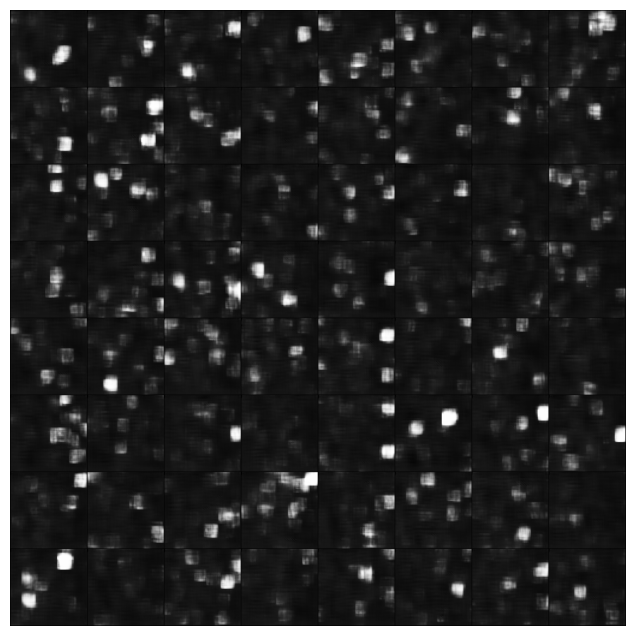

[68/70][850/1319]	Loss_D: 0.9943	Loss_G: 0.6859	D(x): 0.8389	D(G(z)): 0.5239 / 0.5167
[68/70][900/1319]	Loss_D: 0.9479	Loss_G: 0.7212	D(x): 0.8238	D(G(z)): 0.5108 / 0.4876


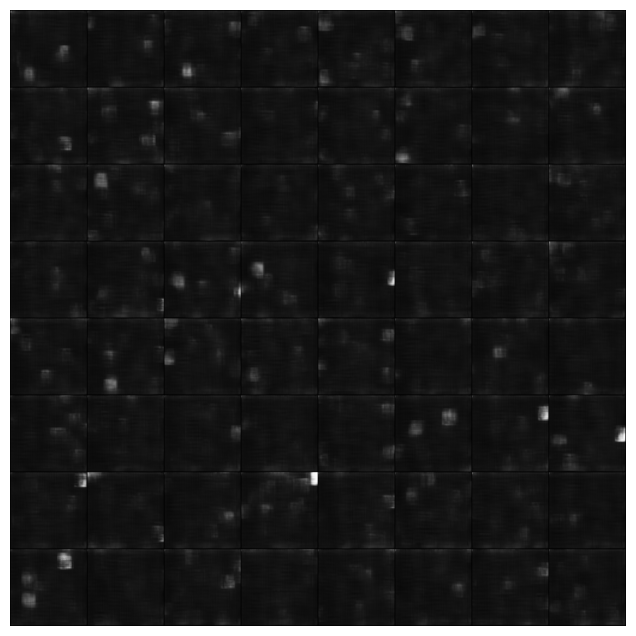

[68/70][950/1319]	Loss_D: 0.9620	Loss_G: 0.6555	D(x): 0.8394	D(G(z)): 0.5192 / 0.5203
[68/70][1000/1319]	Loss_D: 1.0316	Loss_G: 0.6489	D(x): 0.8566	D(G(z)): 0.5520 / 0.5361


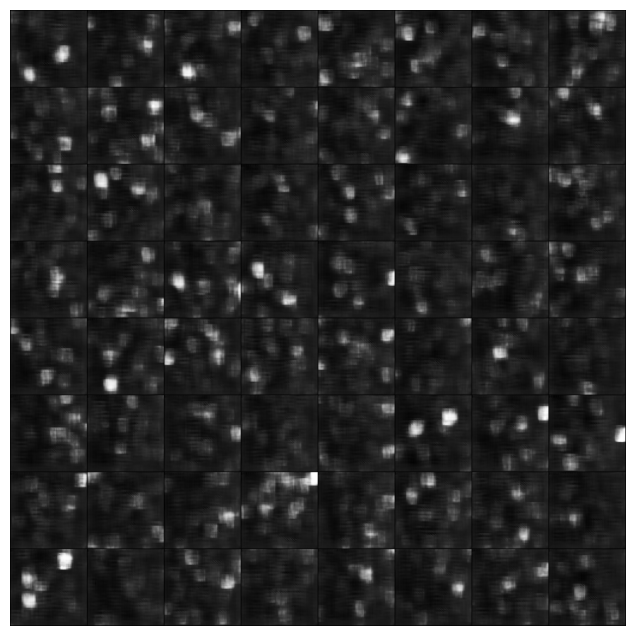

[68/70][1050/1319]	Loss_D: 1.0378	Loss_G: 0.7161	D(x): 0.7697	D(G(z)): 0.4908 / 0.5004
[68/70][1100/1319]	Loss_D: 0.9303	Loss_G: 0.7201	D(x): 0.8196	D(G(z)): 0.4919 / 0.4911


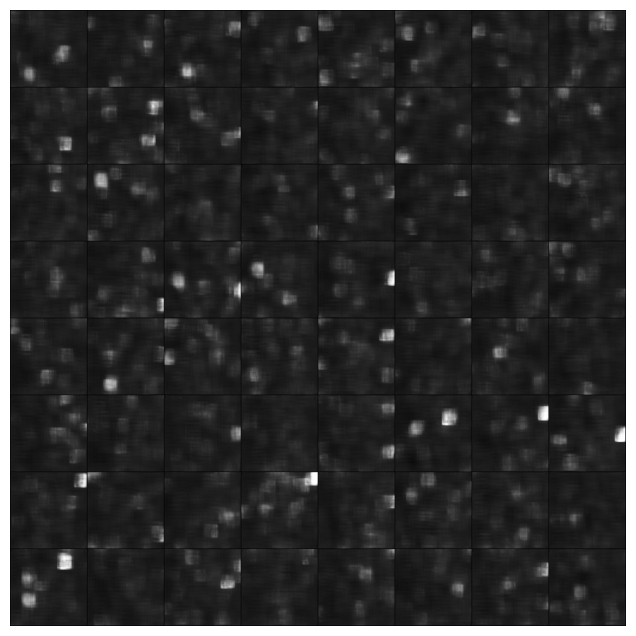

[68/70][1150/1319]	Loss_D: 1.0145	Loss_G: 0.7039	D(x): 0.7914	D(G(z)): 0.4988 / 0.5002
[68/70][1200/1319]	Loss_D: 0.9933	Loss_G: 0.6670	D(x): 0.8211	D(G(z)): 0.5223 / 0.5201


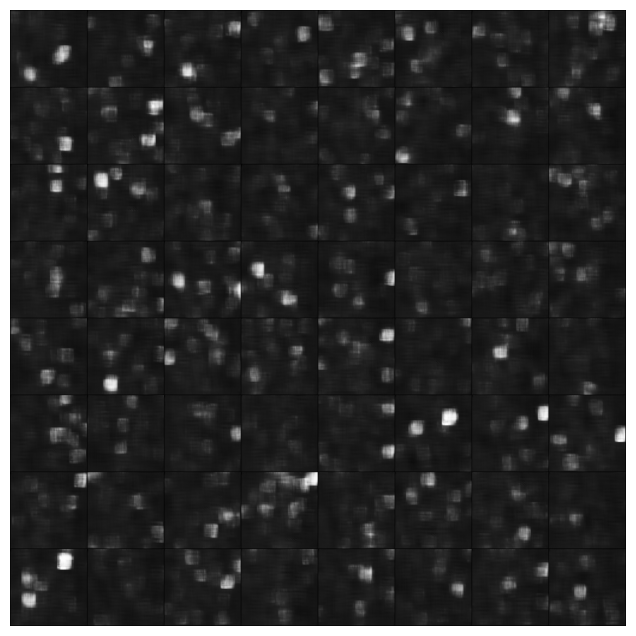

[68/70][1250/1319]	Loss_D: 1.0138	Loss_G: 0.6090	D(x): 0.8806	D(G(z)): 0.5603 / 0.5572
[68/70][1300/1319]	Loss_D: 0.9391	Loss_G: 0.6930	D(x): 0.8413	D(G(z)): 0.5120 / 0.5050


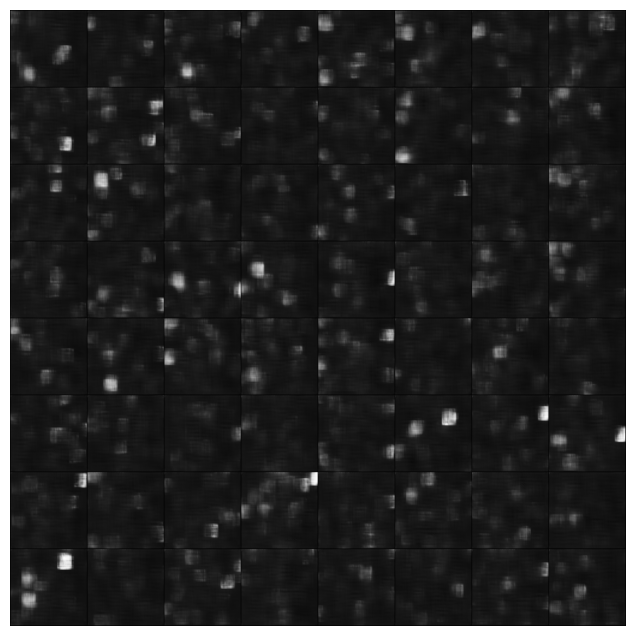

[69/70][0/1319]	Loss_D: 0.9807	Loss_G: 0.7201	D(x): 0.7947	D(G(z)): 0.5079 / 0.4875
[69/70][50/1319]	Loss_D: 0.9446	Loss_G: 0.6534	D(x): 0.8524	D(G(z)): 0.5281 / 0.5231
[69/70][100/1319]	Loss_D: 1.0372	Loss_G: 0.6748	D(x): 0.8247	D(G(z)): 0.5278 / 0.5262
[69/70][150/1319]	Loss_D: 1.1181	Loss_G: 0.5829	D(x): 0.8864	D(G(z)): 0.5846 / 0.5805
[69/70][200/1319]	Loss_D: 1.0479	Loss_G: 0.6570	D(x): 0.8136	D(G(z)): 0.5315 / 0.5300
[69/70][250/1319]	Loss_D: 0.8959	Loss_G: 0.7066	D(x): 0.8338	D(G(z)): 0.4905 / 0.4940
[69/70][300/1319]	Loss_D: 1.0056	Loss_G: 0.6607	D(x): 0.7905	D(G(z)): 0.5133 / 0.5190
[69/70][350/1319]	Loss_D: 0.9280	Loss_G: 0.6874	D(x): 0.8364	D(G(z)): 0.5038 / 0.5072
[69/70][400/1319]	Loss_D: 1.0014	Loss_G: 0.6670	D(x): 0.8141	D(G(z)): 0.5192 / 0.5165
[69/70][450/1319]	Loss_D: 0.8689	Loss_G: 0.7814	D(x): 0.8295	D(G(z)): 0.4739 / 0.4605
[69/70][500/1319]	Loss_D: 1.2354	Loss_G: 0.4866	D(x): 0.8213	D(G(z)): 0.6253 / 0.6153
[69/70][550/1319]	Loss_D: 0.8252	Loss_G: 0.8204	D(x): 0.8

In [26]:
img_list = []
G_losses = np.load("/kaggle/input/40-epochs-result/G_losses.pkl", allow_pickle = True)
D_losses = np.load("/kaggle/input/40-epochs-result/D_losses.pkl", allow_pickle = True)
D_real_losses = np.load("/kaggle/input/40-epochs-result/D_real_losses.pkl", allow_pickle = True)
D_fake_losses = np.load("/kaggle/input/40-epochs-result/D_fake_losses.pkl", allow_pickle = True)
iters = 0

print("Starting Training Loop...")
netG.train()
netD.train()
for epoch in range(41,num_epochs+1):
    for i, data in enumerate(dataloader, 0):
         ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        
        ##train with all reals
        netD.zero_grad()
        #setup batch
        real_cpu = data.to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,1), real_label, dtype=torch.float, device = device)
        
        #fwd pass thru D
        output = netD(real_cpu)
        #calc loss on real
        errD_real = criterion(output, label)
        #calc grads for D
        errD_real.backward()
        D_x = output.mean().item()
        
        ##train with all fakes
        #gen batch of latent
        noise = torch.randn(b_size, 256*256,1,1, device = device)
        #generate fake batch by G
#         print(noise.shape)
        fake = netG(noise)
        label.fill_(fake_label)
        #classify all fakes with D
        output = netD(fake.detach())
        #calc D's loss
        errD_fake = criterion(output, label)
        #calc gradients accumulates with prev grads
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        #compute errD as sum of fake and real
        errD = errD_real + errD_fake
        
        #update D
        
        optimizerD.step()
        
        
        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        
        netG.zero_grad()
        label.fill_(real_label)# fake labels are real for generator cost
        output = netD(fake)
#         print(output)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()
        
        if i%50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        D_real_losses.append(errD_real.item())
        D_fake_losses.append(errD_fake.item())
        
        if (epoch % 4 == 0) and (i%100 == 0):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            fig = plt.figure(figsize=(8,8))
            plt.axis("off")
            ims = [[ plt.imshow(np.transpose(i,(1,2,0)), cmap = 'gray')]for i in img_list]
            plt.show()
            
            img_list = []
        
    if(epoch%5 == 0):
        # Additional information
        PATH = f"/kaggle/working/checkpoints/{epoch}_GAN.pt"
        torch.save({

            'Gen_state_dict': netG.state_dict(),
            'Disc_state_dict': netD.state_dict(),
            'optimizerG_state_dict': optimizerG.state_dict(),
            'optimizerD_state_dict': optimizerD.state_dict(),
        }, PATH)

        iters += 1
PATH = f"/kaggle/working/checkpoints/last_GAN.pt"
torch.save({

    'Gen_state_dict': netG.state_dict(),
    'Disc_state_dict': netD.state_dict(),
    'optimizerG_state_dict': optimizerG.state_dict(),
    'optimizerD_state_dict': optimizerD.state_dict(),
}, PATH)

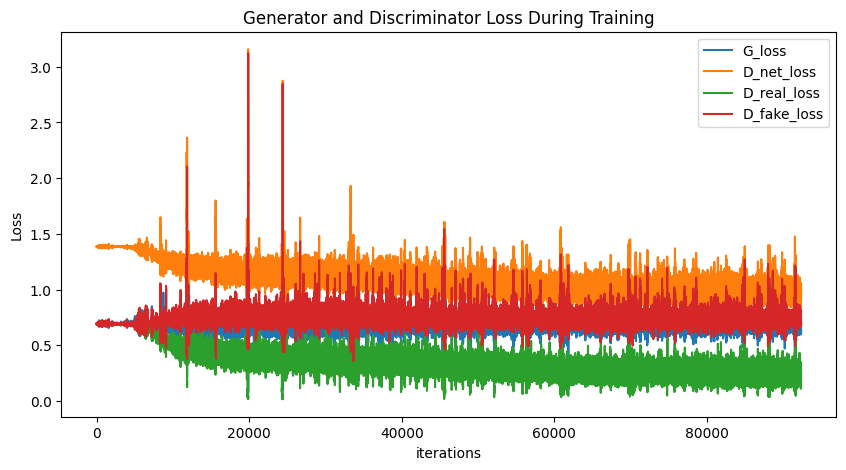

In [27]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G_loss")
plt.plot(D_losses,label="D_net_loss")
plt.plot(D_real_losses, label = "D_real_loss")
plt.plot(D_fake_losses, label = "D_fake_loss")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.savefig("Losses graph.png")
plt.show()

In [28]:
!zip -r checkpoints.zip /kaggle/working/checkpoints

  adding: kaggle/working/checkpoints/ (stored 0%)
  adding: kaggle/working/checkpoints/70_GAN.pt (deflated 8%)
  adding: kaggle/working/checkpoints/last_GAN.pt (deflated 8%)
  adding: kaggle/working/checkpoints/45_GAN.pt (deflated 8%)
  adding: kaggle/working/checkpoints/60_GAN.pt (deflated 8%)
  adding: kaggle/working/checkpoints/50_GAN.pt (deflated 8%)
  adding: kaggle/working/checkpoints/65_GAN.pt (deflated 8%)
  adding: kaggle/working/checkpoints/55_GAN.pt (deflated 8%)


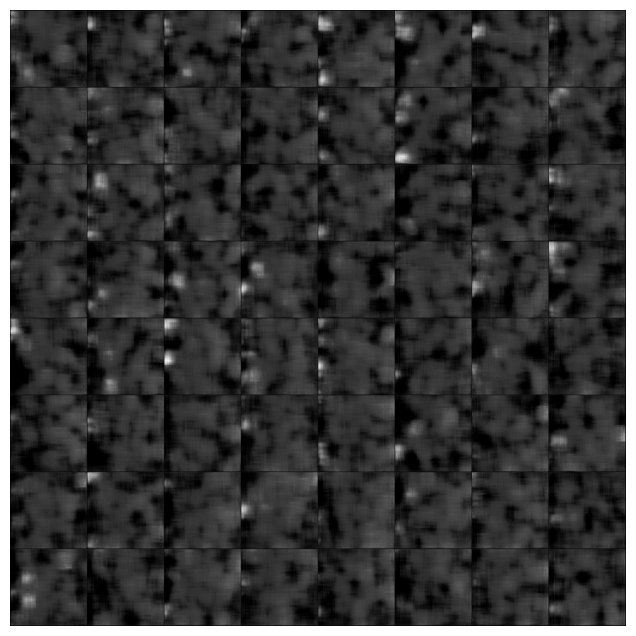

In [29]:
img_list = []
with torch.no_grad():
    fake = netG(fixed_noise).detach().cpu()
img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[ plt.imshow(np.transpose(i,(1,2,0)), cmap = 'gray')]for i in img_list]
plt.show()

In [30]:
!mkdir losses

In [31]:
with open('/kaggle/working/losses/G_losses.pkl', 'wb') as f:
    pickle.dump(G_losses, f)

with open('/kaggle/working/losses/D_losses.pkl', 'wb') as f:
    pickle.dump(D_losses, f)

with open('/kaggle/working/losses/D_real_losses.pkl', 'wb') as f:
    pickle.dump(D_real_losses, f)
    
with open('/kaggle/working/losses/D_fake_losses.pkl', 'wb') as f:
    pickle.dump(D_fake_losses, f)

In [32]:
!zip -r losses.zip /kaggle/working/losses

  adding: kaggle/working/losses/ (stored 0%)
  adding: kaggle/working/losses/G_losses.pkl (deflated 58%)
  adding: kaggle/working/losses/D_fake_losses.pkl (deflated 57%)
  adding: kaggle/working/losses/D_real_losses.pkl (deflated 55%)
  adding: kaggle/working/losses/D_losses.pkl (deflated 58%)
